En este notebook tomamos el avión y lo segmentamos para tratar de encontrar el área deintersección entre las dos nubes usando el DPDist. Los resultados en algunos casos son buenos, pero en otros son muy malos

In [ ]:
import os
from google.colab import drive
drive.mount('/content/drive')
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/')
!pwd

Mounted at /content/drive
/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes


In [ ]:
import os
import tensorflow.compat.v1 as tf
import numpy as np
import matplotlib.pyplot as plt

#Funciones de muestreo y normalización.

In [ ]:
def pc_normalize(pc):
    l = pc.shape[0]
    centroid = np.mean(pc, axis=0)
    #centroid = np.mean(pc)
    #print(centroid.shape)
    pc = pc - centroid
    m = np.max(np.sqrt(np.sum(pc**2, axis=1)))
    #m = np.max(np.sqrt(np.sum(pc**2)))
    pc = pc / m
    return pc

In [ ]:
def muestro_resimple(pointCloudA, pointCloudB, num_points=64, num_batches=16, isNormalized=True):
  #muestreo simple de datos
  pcA = pointCloudA[0:num_points*num_batches, :]
  pcB = pointCloudB[0:num_points*num_batches, :]
    #normalizacion
  if (isNormalized == False):  
    pcA = pc_normalize(pcA)
    pcB = pc_normalize(pcB)

  return pcA, pcB


#Función de puntos coincidentes

In [ ]:
def p_coincidentes_PcAyPcB(similaresAB, similaresBA):
  coincidentes=[]
  similares = similaresAB
  similares2 = similaresBA
  if len(similares)<len(similares2):
    for i in range(len(similares)):
      for j in range(len(similares)):
        if(similares[i]==similares2[j]):
          coincidentes.append(similares[i])
  else:
    for i in range(len(similares2)):
      for j in range(len(similares2)):
        if(similares2[i]==similares[j]):
          coincidentes.append(similares2[i])
  
  return coincidentes

#Función del vecino más cercano

In [ ]:
def nearest_neighbor(src, dst):
    from sklearn.neighbors import NearestNeighbors
    #Encuentra el vecino más cercano mediante el método euclidiano
    #src Matriz de puntos origen
    #dst Matriz de puntos destino
    #Retorna las distancias euclidianas del vecino más cercano y sus indices

    if (src.shape == dst.shape): #Verifica que las nubes de puntos tengan la misma dimensión
      
      neigh = NearestNeighbors(n_neighbors=1) #Busca un vecino 
      neigh.fit(dst) #Ajusta el estimador de vecinos más cercanos del conjunto de datos de entrenamiento
      distances, indices = neigh.kneighbors(src, return_distance=True) #Encuentra los K-vecinos de un punto
    
    else:
      print('Las dimensiones de las nubes de puntos no corresponden o son diferentes' )

    
    return distances.ravel(), indices.ravel()

#Funciones de Rotación

In [ ]:
def X_axis_rotation_matrix(theta):
    return np.array([[1,             0,              0],
                     [0, np.cos(theta), -np.sin(theta)],
                     [0, np.sin(theta),  np.cos(theta)]])

In [ ]:
def Y_axis_rotation_matrix(theta):
    return np.array([[np.cos(theta),  0,  np.sin(theta)],
                     [0,              1,              0],
                     [-np.sin(theta), 0,  np.cos(theta)]])

In [ ]:
def Z_axis_rotation_matrix(theta):
    return np.array([[np.cos(theta),   -np.sin(theta),    0],
                     [np.sin(theta),    np.cos(theta),    0],
                     [0,                0,                1]])

#Cargamos DPDist

In [ ]:
config = tf.ConfigProto()
config.gpu_options.allow_growth = True
config.allow_soft_placement = True
config.log_device_placement = False
sess3 = tf.InteractiveSession(config=config)

In [ ]:
os.chdir('/content/drive/MyDrive/PROYECTO DE GRADO/Code/DPDist-master/log/test1__imp_type_1enc_3dmfvEmbS512BN0LR0001wd0sigma125K5AUG1lsl1_distnoise0chairov1np64')

In [ ]:

from tensorflow.python.framework import graph_util
tf.disable_eager_execution()
saver = tf.train.import_meta_graph('./model.ckpt.meta', import_scope='g1', clear_devices=True)
sess3.run(tf.global_variables_initializer())
sess3.run(tf.local_variables_initializer())
saver.restore(sess3, tf.train.latest_checkpoint(os.path.expanduser('./')))

output_node_names = 'g1/pc_compare/output1,g1/pc_compare/output2,g1/gpu_0/total_loss_pred'

# for fixing the bug of batch norm
gd = sess3.graph.as_graph_def()
for node in gd.node:            
    if node.op == 'RefSwitch':
        node.op = 'Switch'
        for index in xrange(len(node.input)):
            if 'moving_' in node.input[index]:
                node.input[index] = node.input[index] + '/read'
    elif node.op == 'AssignSub':
        node.op = 'Sub'
        if 'use_locking' in node.attr: del node.attr['use_locking']
    elif node.op == 'AssignAdd':
        node.op = 'Add'
        if 'use_locking' in node.attr: del node.attr['use_locking']
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/Registro de Nubes')
converted_graph_def = graph_util.convert_variables_to_constants(sess3, gd, output_node_names.split(","))
tf.train.write_graph(converted_graph_def, "./", "FREEZE_DPDIST.pb", as_text=False)

INFO:tensorflow:Restoring parameters from ./model.ckpt
Instructions for updating:
Use `tf.compat.v1.graph_util.convert_variables_to_constants`
Instructions for updating:
Use `tf.compat.v1.graph_util.extract_sub_graph`


'./FREEZE_DPDIST.pb'

In [ ]:
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/Registro de Nubes')

In [ ]:
import os
import tensorflow.compat.v1 as tf
import numpy as np
import matplotlib.pyplot as plt

from tensorflow.python.framework import graph_util

# DPDIST

def cargar_modelo_congelado(path):
  from tensorflow.python.platform import gfile
  model_path=path

  # read graph definition
  f = gfile.FastGFile(model_path, "rb")
  gd = graph_def = tf.GraphDef()
  graph_def.ParseFromString(f.read())

  # fix nodes
  for node in graph_def.node:
      if node.op == 'RefSwitch':
          node.op = 'Switch'
          for index in xrange(len(node.input)):
              if 'moving_' in node.input[index]:
                  node.input[index] = node.input[index] + '/read'
      elif node.op == 'AssignSub':
          node.op = 'Sub'
          if 'use_locking' in node.attr: del node.attr['use_locking']

  # import graph into session
  with tf.Graph().as_default() as graph:
    tf.import_graph_def(graph_def, name='')
    tf.train.write_graph(graph_def, './', 'good_frozen.pb', as_text=False)
    tf.train.write_graph(graph_def, './', 'good_frozen.pbtxt', as_text=True)

  return graph

graph = cargar_modelo_congelado("./FREEZE_DPDIST.pb")

def pc_normalize(pc):
    l = pc.shape[0]
    centroid = np.mean(pc, axis=0)
    pc = pc - centroid
    m = np.max(np.sqrt(np.sum(pc**2, axis=1)))
    pc = pc / m
    return pc

def crearsession(graph):
  config = tf.ConfigProto()
  config.gpu_options.allow_growth = True
  config.allow_soft_placement = True
  config.log_device_placement = False
  sess = tf.InteractiveSession(config=config, graph=graph)
  return sess

def muestro_resimple(pointCloudA, pointCloudB, num_points=64, num_batches=16):
  #muestreo simple de datos
  pcA = pointCloudA[0:num_points*num_batches, :]
  pcB = pointCloudB[0:num_points*num_batches, :]
    #normalizacion
  pcA = pc_normalize(pcA)
  pcB = pc_normalize(pcB)

  return pcA, pcB


def muestro_resimple2(pointCloudA, pointCloudB, num_points=64, num_batches=16):
  #muestreo simple de datos
  pcA = pointCloudA[0:num_points*num_batches, :]
  pcB = pointCloudB[num_points*num_batches:int((num_points*num_batches)*2), :]
    #normalizacion
  pcA = pc_normalize(pcA)
  pcB = pc_normalize(pcB)

  return pcA, pcB


def crear_inputs(pointCloudA, pointCloudB, num_points, num_batches):

  #inputs
  input1 = pointCloudA.reshape(num_batches, num_points, pointCloudA.shape[1])
  input2 = pointCloudB.reshape(num_batches,  num_points ,pointCloudB.shape[1])
  noise = np.zeros((num_batches, num_points, 3))

  return input1, input2, noise

def DPDist(pointCloudA, pointCloudB, freeze_graph=graph, num_points=64, num_batches=16):

  input_1, input_2, noise = crear_inputs(pointCloudA, pointCloudB, num_points, num_batches)

  sess=crearsession(graph)


  ## NOW the complete graph with values has been restored
  pred_AB = (graph.get_tensor_by_name('g1/pc_compare/output1:0'))
  pred_BA = (graph.get_tensor_by_name('g1/pc_compare/output2:0'))
  loss = (graph.get_tensor_by_name('g1/gpu_0/loss_pred:0'))
  ## Let's feed the images to the input placeholders
  x1= graph.get_tensor_by_name('g1/input1:0')
  x2= graph.get_tensor_by_name('g1/input2:0')
  x3= graph.get_tensor_by_name("g1/add_noise:0")
  #y_test_images = np.zeros((1, 2))
  #sess= tf.Session(graph=graph)
  ### Creating the feed_dict that is required to be fed to calculate y_pred 
  feed_dict_testing = {}
  feed_dict_testing = {x1: input_1, x2: input_2,  x3: noise}
  resultAB =sess.run(pred_AB, feed_dict=feed_dict_testing)
  resultBA=sess.run(pred_BA, feed_dict=feed_dict_testing)

  #DPDist entre nubes
  resultAB_0 = resultAB[:,:,:,0]
  resultBA_0 = resultBA[:,:,:,0]  
  resultAB_0 = resultAB_0.reshape(1024)
  resultBA_0 = resultBA_0.reshape(1024)
  dist_pcA_pcB=((1/pointCloudA.shape[0])*np.sum(resultAB_0))+((1/pointCloudB.shape[0])*np.sum(resultBA_0))
  
  sess.close()

  return resultAB_0, resultBA_0, dist_pcA_pcB

def plottear_DPDist(DistAB, DistBA, pcA, pcB):
  from matplotlib import pyplot as plt
  from mpl_toolkits.mplot3d import Axes3D

  fig = plt.figure(figsize=(40,15))
  ax = fig.add_subplot(1, 3, 3, projection='3d')

  c = DistAB.reshape(1024)
  c= c[0:512]
  color_map = plt.get_cmap('jet')
  scatter_plot = ax.scatter3D(pcB[0:512,0], pcB[0:512,1], pcB[0:512,2], s=100, c=c, cmap = color_map)
  #scatter_plot2 = ax.scatter3D(pcA1024[:,0], pcA1024[:,1], pcA1024[:,2], c='blue', s=100, cmap = color_map)
  plt.colorbar(scatter_plot)
  
  # Show plot

  plt.show()

##Cargando Modelos del txt



Instructions for updating:
Use tf.gfile.GFile.


#1. Avion

##Cargar modelo

In [ ]:
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/')

ptts = np.loadtxt('./data/airplane/airplane_0002.txt', delimiter=',', usecols=(0,1,2))
#ptts = ptts[:1000]

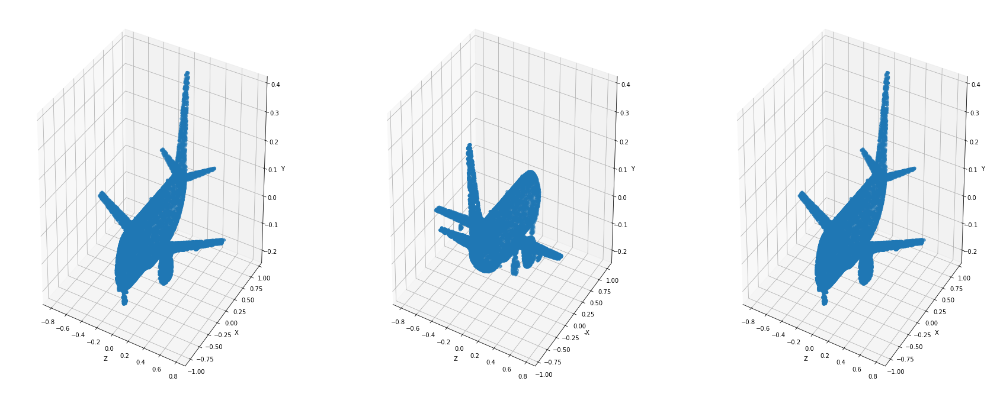

In [ ]:
fig = plt.figure(figsize=(30,12))


ax = fig.add_subplot(1, 3, 1, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax2 = fig.add_subplot(1, 3, 2, projection='3d', sharex=ax)
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax2.scatter3D(Z,-X,Y)
ax2.set_xlabel('Z')
ax2.set_ylabel('-X')
ax2.set_zlabel('Y')


ax3 = fig.add_subplot(1, 3, 3, projection='3d', sharex=ax)
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]
ax3.scatter3D(Z,X,Y)
ax3.set_xlabel('Z')
ax3.set_ylabel('X')
ax3.set_zlabel('Y')

plt.show()

##1.1 Primer segmento, todo diferente menos la cabina, con divisiones irregulares

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if (ptts[i][0]>-0.5 and ptts[i][0]<-0.32) or (ptts[i][0]>0.1 and ptts[i][0]<0.6) or (ptts[i][0]>0.8):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0]<-0.5):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

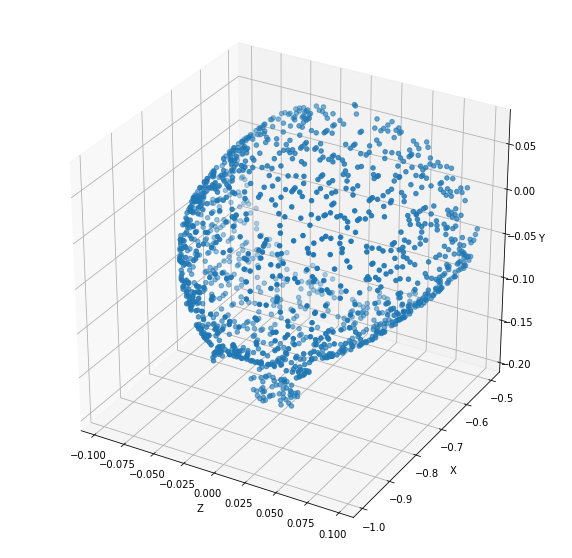

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

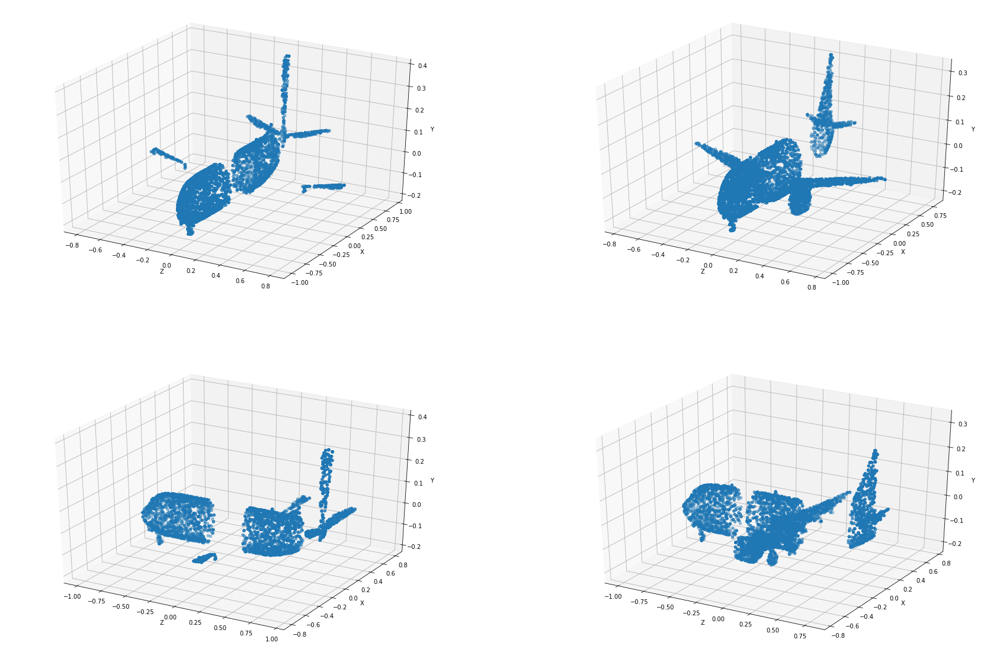

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

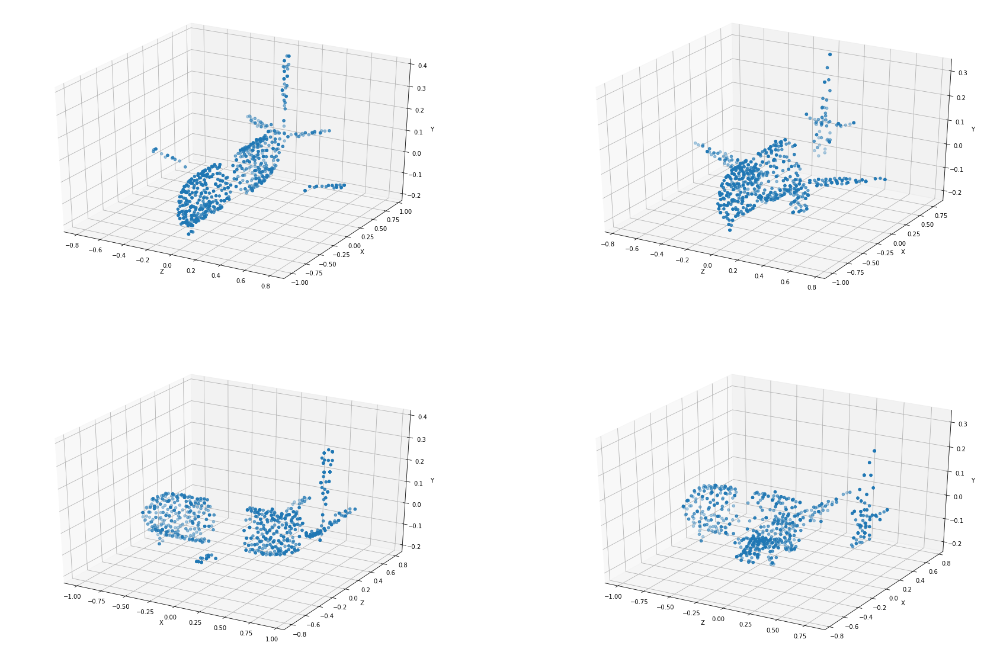

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.1.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.226784
1,1,1,0.226784
2,2,2,0.039936
3,3,3,0.039936
4,4,4,0.039936
...,...,...,...
1019,1019,1019,0.000000
1020,1020,1020,0.000000
1021,1021,1021,0.023982
1022,1022,1022,0.000000


In [ ]:
similaresB=[]
diferentesB=[]
simB = []
difB = []
rango = 0.00001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similaresB.append(m['m_punto_pcB'][i])
    simB.append(pcB[i])
  else:
    diferentesB.append(m['m_punto_pcB'][i])
    difB.append(pcB[i])

In [ ]:
len(similaresB)

551

In [ ]:
len(diferentesB)

473

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similaresB)):
    if(similaresB[j]==i):
      dst = distance.euclidean(pcA[similaresB[j]], pcB[similaresB[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
difB = np.array(difB)
simB = np.array(simB)

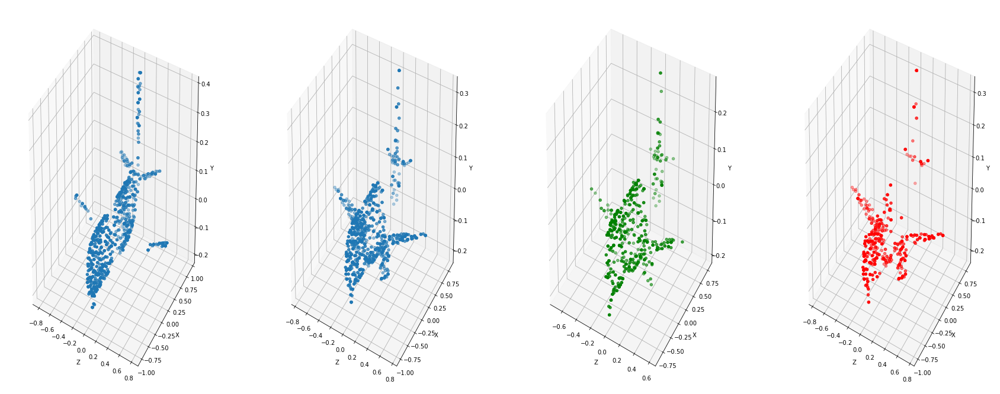

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = simB[:,0]
Y = simB [:,1]
Z = simB[:,2]
ax.scatter3D(Z,X,Y, c='green')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = difB[:,0]
Y = difB [:,1]
Z = difB[:,2]
ax.scatter3D(Z,X,Y, c='red')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.08195857900663273, 0.010980367528814674, 'Y')

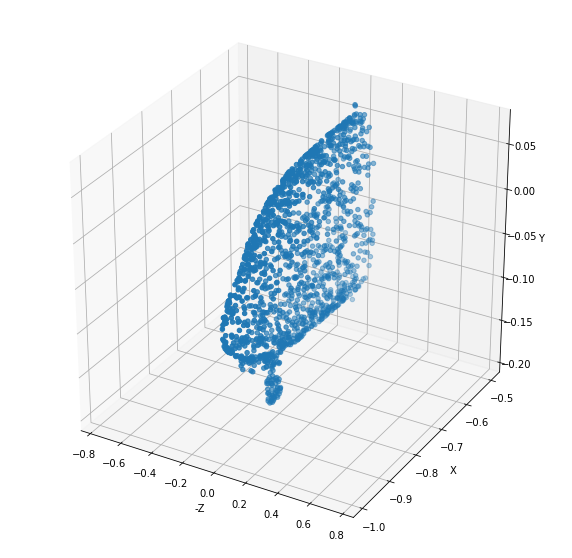

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax1 = fig.add_subplot(1, 1, 1, projection='3d', sharex=ax, sharey=ax)
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax1.scatter3D(Z,X,Y)
ax1.set_xlabel('-Z')
ax1.set_ylabel('X')
ax1.set_zlabel('Y')

####1.1.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.221258
1,1,1,0.221258
2,2,2,0.221258
3,3,3,0.221258
4,4,4,0.221258
...,...,...,...
1019,1019,1019,0.093053
1020,1020,1020,0.000000
1021,1021,1021,0.116523
1022,1022,1022,0.082808


In [ ]:
similaresA=[]
diferentesA=[]
simA = []
difA = []
rango = 0.00001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similaresA.append(m['n_punto_pcA'][i])
    simA.append(pcA[i])
  else:
    diferentesA.append(m['n_punto_pcA'][i])
    difA.append(pcA[i])

In [ ]:
len(similaresA)

572

In [ ]:
len(diferentesA)

452

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similaresA)):
    if(similaresA[j]==i):
      dst = distance.euclidean(pcA[similaresA[j]], pcB[similaresA[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
difA = np.array(difA)
simA = np.array(simA)

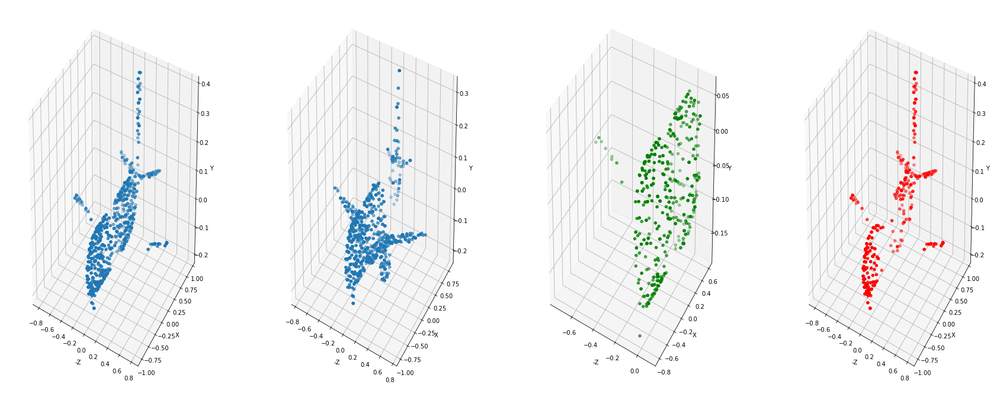

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = simA[:,0]
Y = simA [:,1]
Z = simA[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = difA[:,0]
Y = difA [:,1]
Z = difA[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

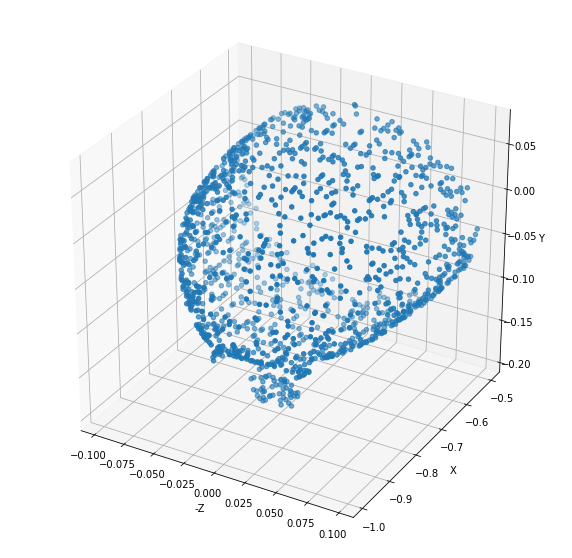

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####Coincidentes

In [ ]:
coincidentesIndices = p_coincidentes_PcAyPcB(similaresA, similaresB)

print(len(coincidentesIndices))

coincidentesNube = []
coincidentesA = []
coincidentesB = []
for x in coincidentesIndices:
  coincidentesNube.append(ptts[x])
  coincidentesA.append(nubeA[x])
  coincidentesB.append(nubeB[x])

coincidentesNube = np.array(coincidentesNube)
coincidentesA = np.array(coincidentesA)
coincidentesB = np.array(coincidentesB)

294


Text(0.5, 0, 'Y')

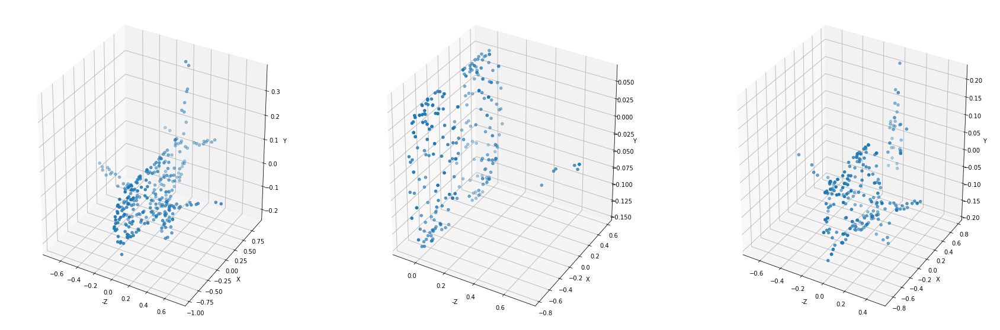

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(30,10))

ax = fig.add_subplot(1, 3, 1, projection='3d')
X = coincidentesNube[:,0]
Y = coincidentesNube[:,1]
Z = coincidentesNube[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(1, 3, 2, projection='3d')
X = coincidentesA[:,0]
Y = coincidentesA[:,1]
Z = coincidentesA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(1, 3, 3, projection='3d')
X = coincidentesB[:,0]
Y = coincidentesB[:,1]
Z = coincidentesB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####Vecino más cercano

In [ ]:
#Ambos tienen la misma cantidad de puntos porque los filtré luego de diseccionar la nube de puntos
print(pcA.shape)
print(pcB.shape)

(1024, 3)
(1024, 3)


In [ ]:
#Hallo los indices de los puntos que son candidatos a puntos de anclaje
distEuclidA, indicesA = nearest_neighbor(pcA, pcB)
distEuclidB, indicesB = nearest_neighbor(pcB, pcA)

distEuclidA, indicesA = nearest_neighbor(pcB, pcA)
distEuclidB, indicesB = nearest_neighbor(pcA, pcB)

NameError: ignored

In [ ]:
zonaA = pcA[indicesA]
zonaB = pcB[indicesB]

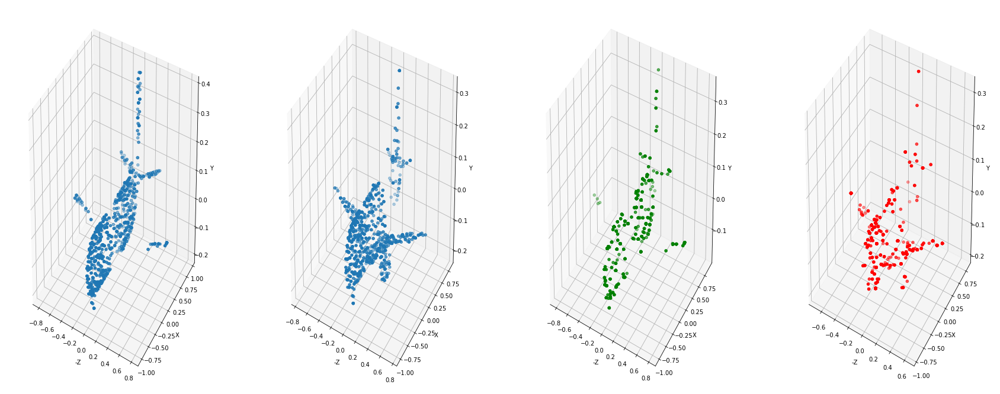

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = zonaA[:,0]
Y = zonaA [:,1]
Z = zonaA[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = zonaB[:,0]
Y = zonaB [:,1]
Z = zonaB[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

##1.2 Segundo Segmento, Modelo dividido en dos con areas en común en la mitad

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0.2 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0.2) and (ptts[i][0] < 0.4):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

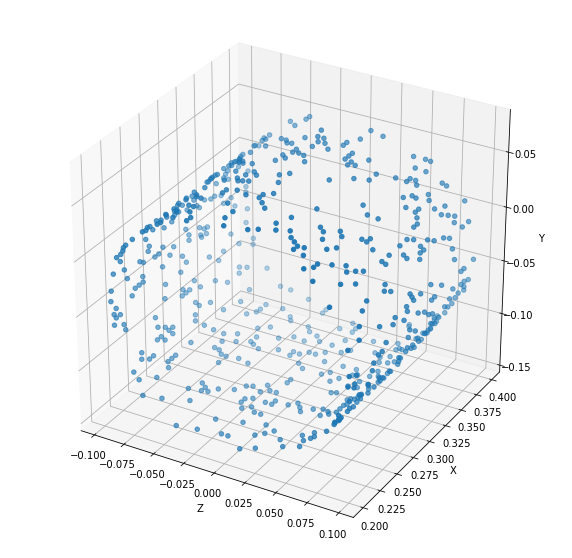

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

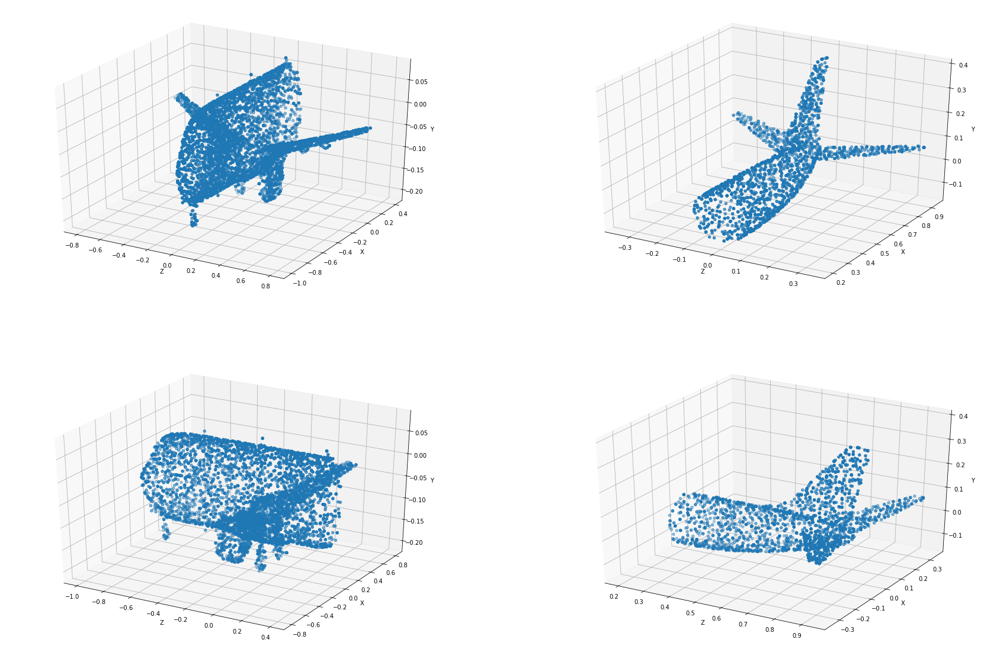

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

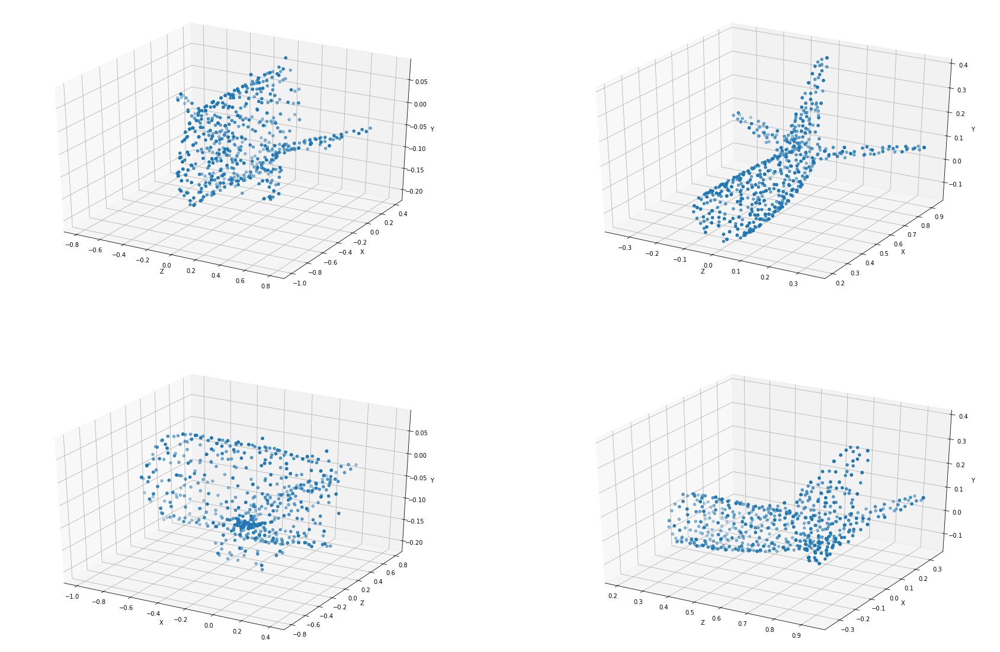

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.2.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.651204
1,1,1,0.651204
2,2,2,0.000000
3,3,3,0.690904
4,4,4,0.651204
...,...,...,...
1019,1019,1019,0.103160
1020,1020,1020,0.497988
1021,1021,1021,0.640565
1022,1022,1022,0.447160


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.000001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

280

In [ ]:
len(diferentes)

744

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

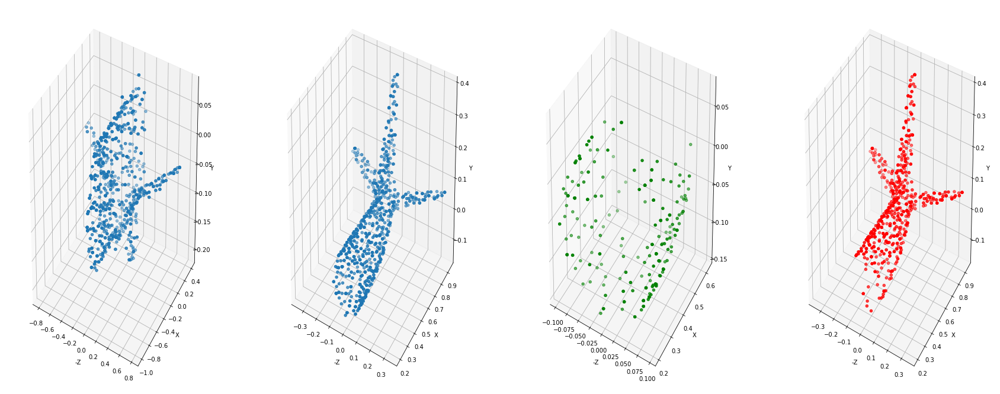

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif[:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

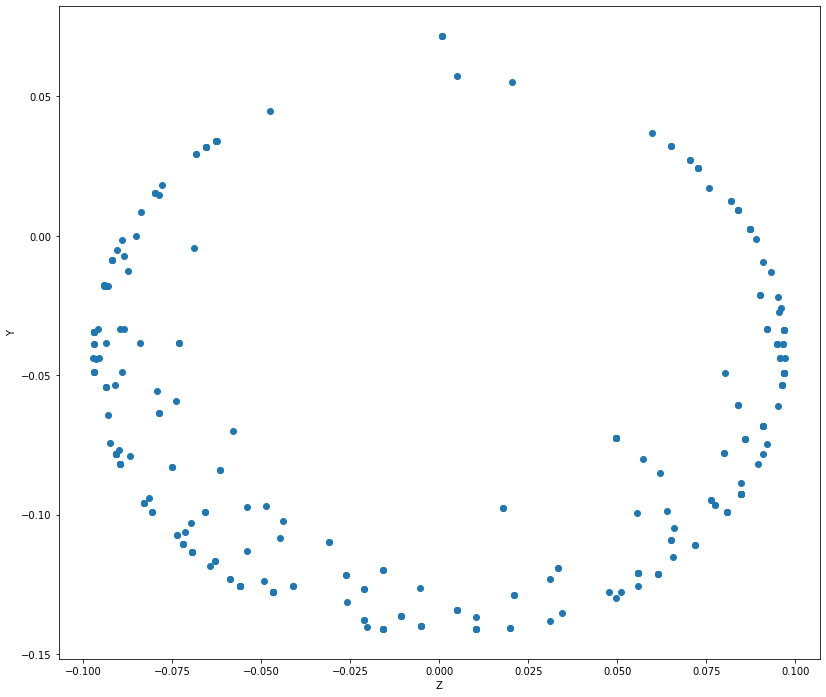

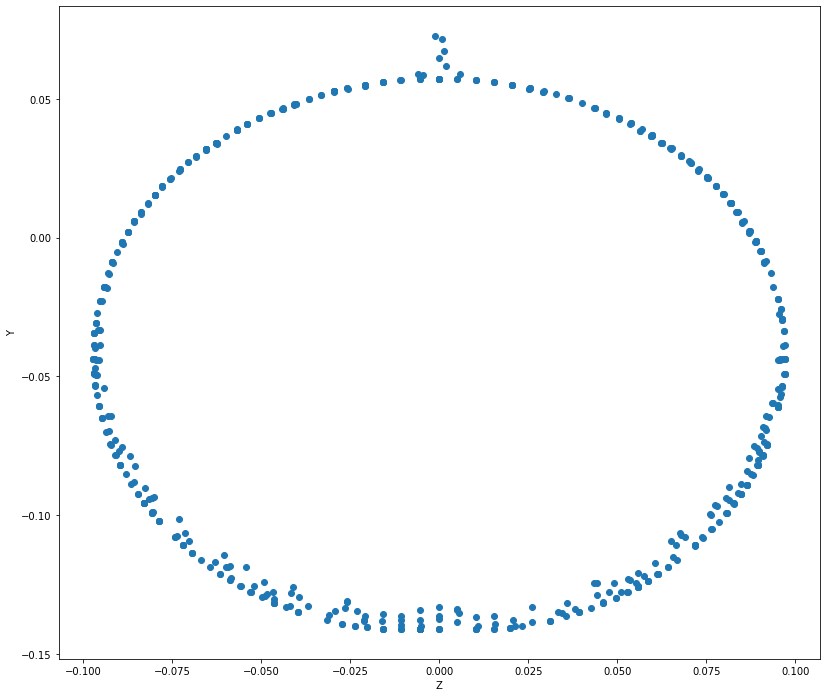

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1)
Y = sim [:,1]
Z = sim[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 2)
Y = inteseccion[:,1]
Z = inteseccion[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

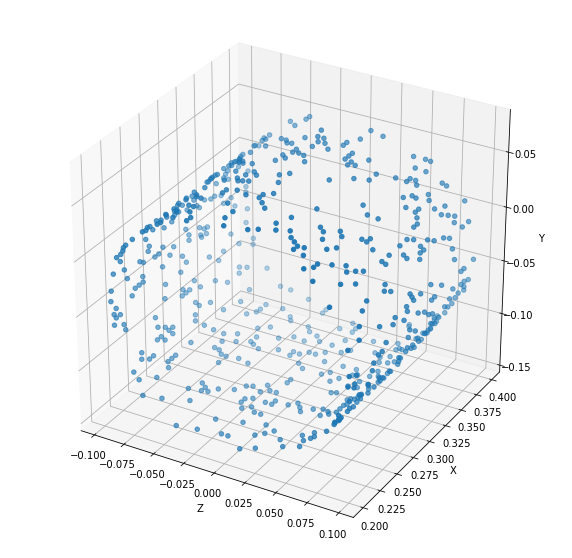

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.2.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.408205
1,1,1,0.714578
2,2,2,0.714578
3,3,3,0.568517
4,4,4,0.747799
...,...,...,...
1019,1019,1019,0.469418
1020,1020,1020,0.339065
1021,1021,1021,0.374328
1022,1022,1022,1.327246


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

79

In [ ]:
len(diferentes)

945

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

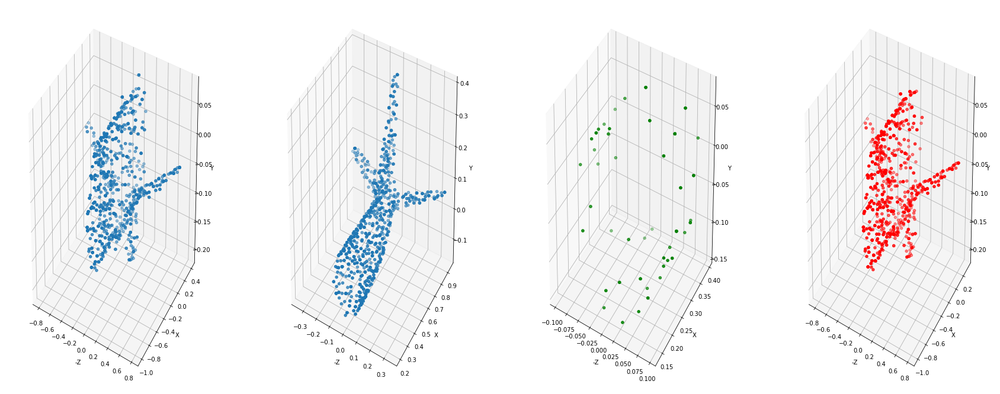

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

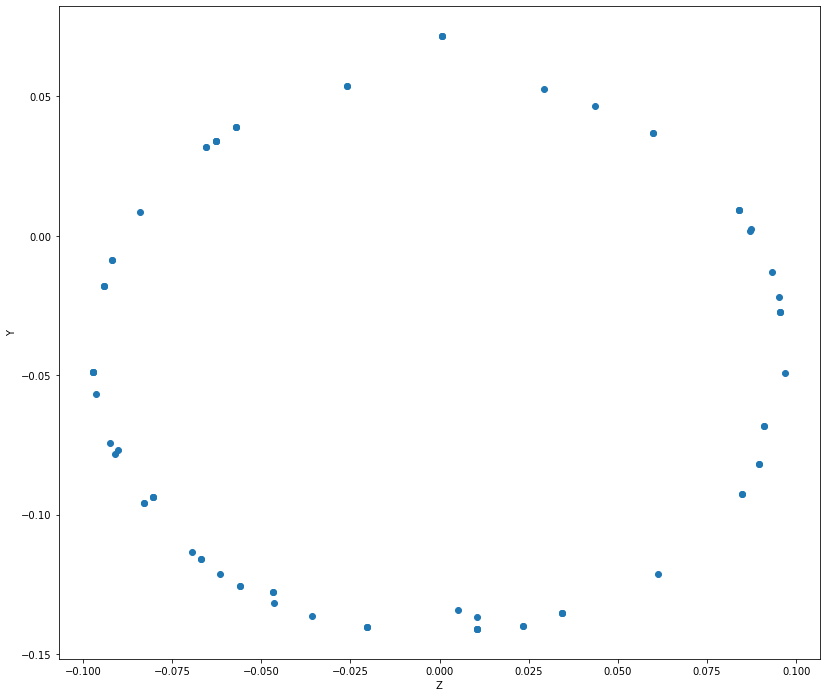

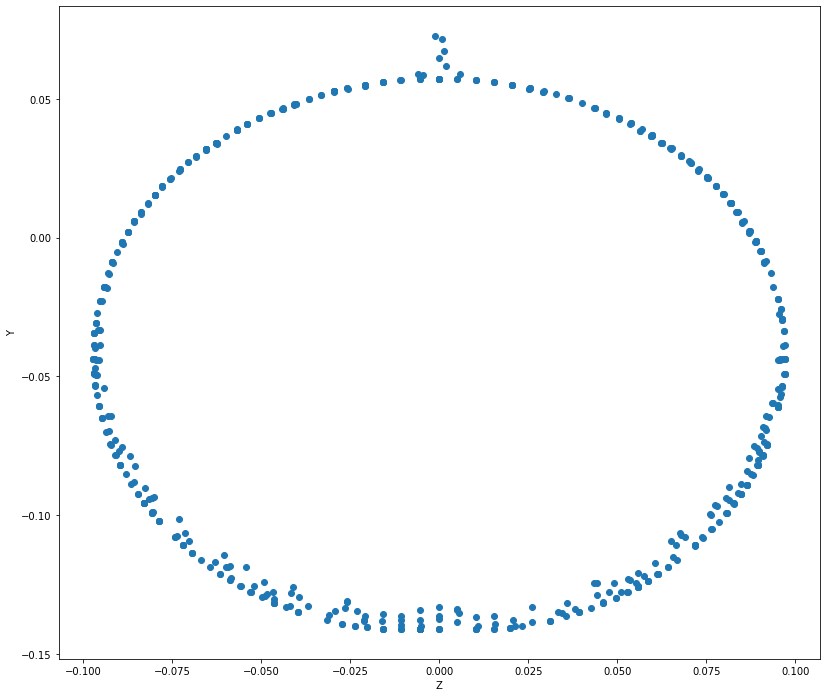

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1)
Y = sim [:,1]
Z = sim[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 2)
Y = inteseccion[:,1]
Z = inteseccion[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

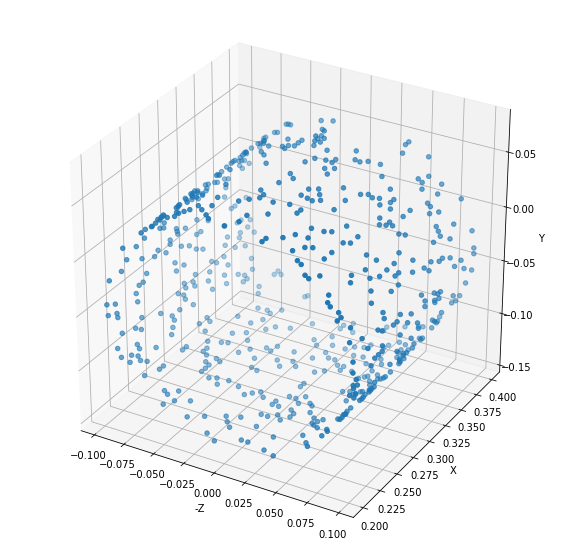

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####Vecino más cercano

In [ ]:
#Ambos tienen la misma cantidad de puntos porque los filtré luego de diseccionar la nube de puntos
print(pcA.shape)
print(pcB.shape)

(1024, 3)
(1024, 3)


In [ ]:
#Hallo los indices de los puntos que son candidatos a puntos de anclaje
distEuclidA, indicesA = nearest_neighbor(pcA, pcB)
distEuclidB, indicesB = nearest_neighbor(pcB, pcA)

In [ ]:
zonaA = pcA[indicesA]
zonaB = pcB[indicesB]

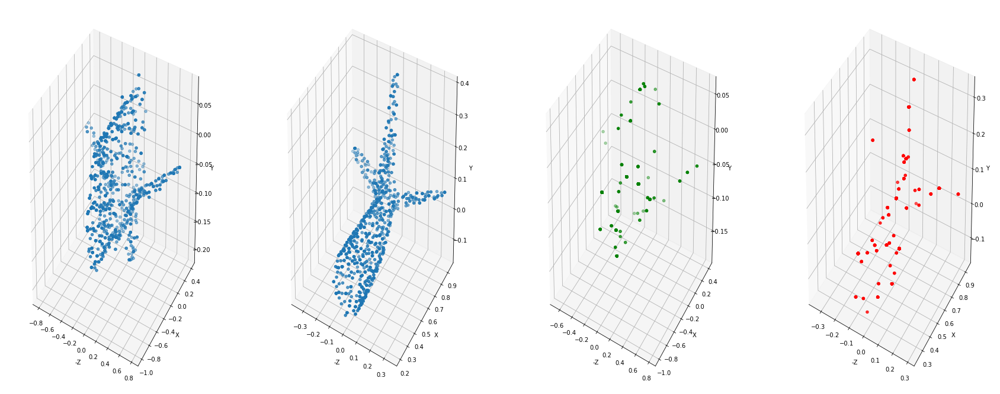

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = zonaA[:,0]
Y = zonaA [:,1]
Z = zonaA[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = zonaB[:,0]
Y = zonaB [:,1]
Z = zonaB[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

##1.3 Tercer Segmento, Modelo dividido en dos con areas en común en la cola

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0.2 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0.6):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

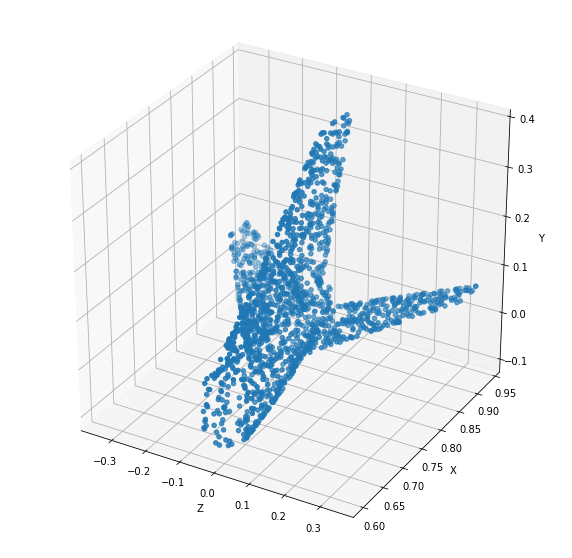

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

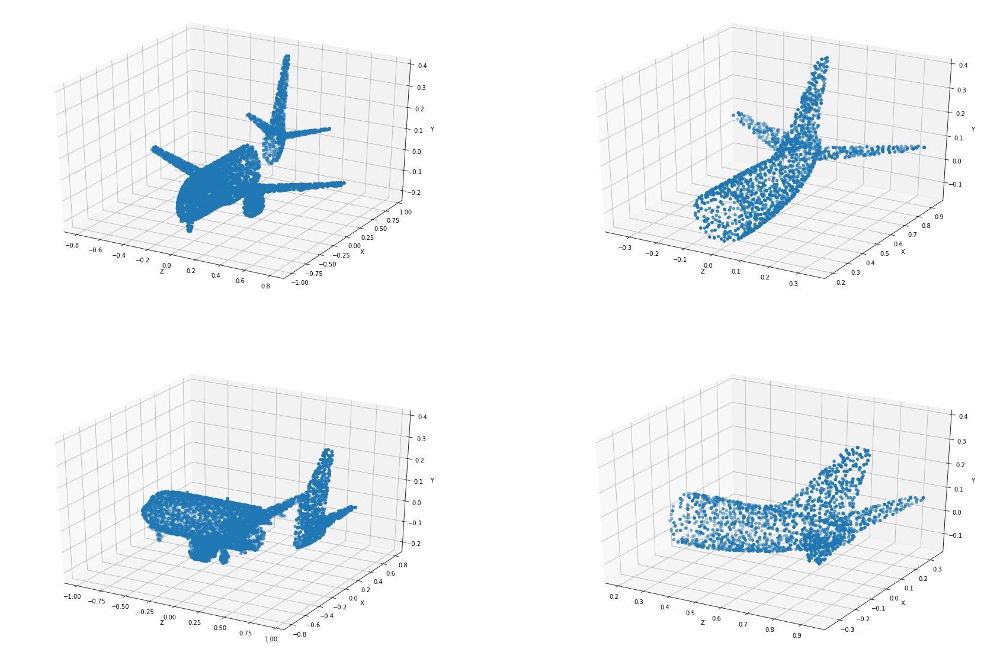

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

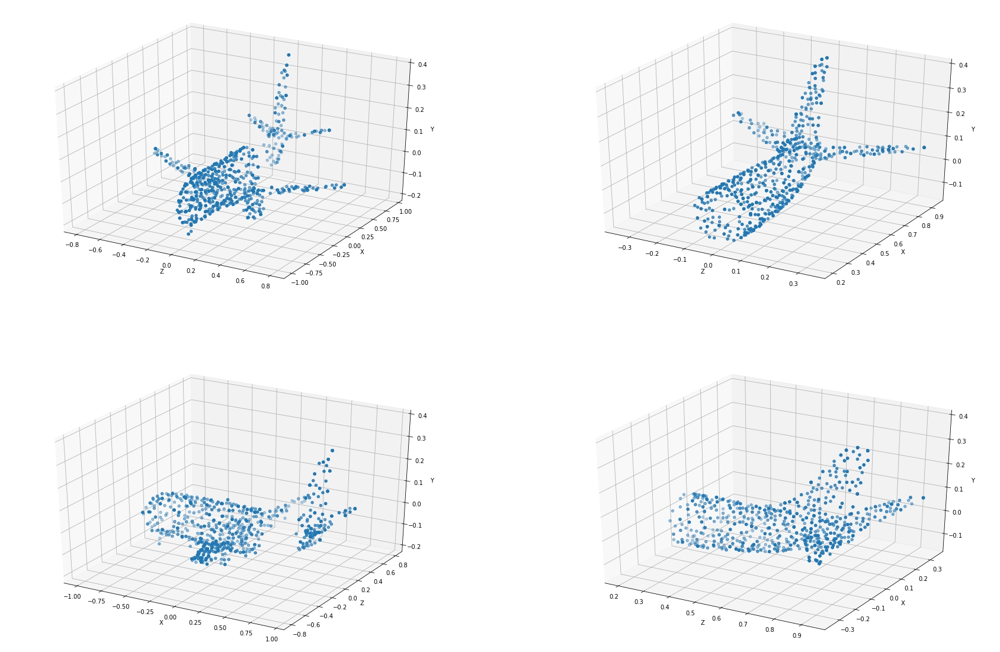

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.3.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.117484
1,1,1,0.000000
2,2,2,0.117484
3,3,3,0.112958
4,4,4,0.000000
...,...,...,...
1019,1019,1019,0.030843
1020,1020,1020,0.029136
1021,1021,1021,0.000000
1022,1022,1022,0.063513


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

463

In [ ]:
len(diferentes)

561

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

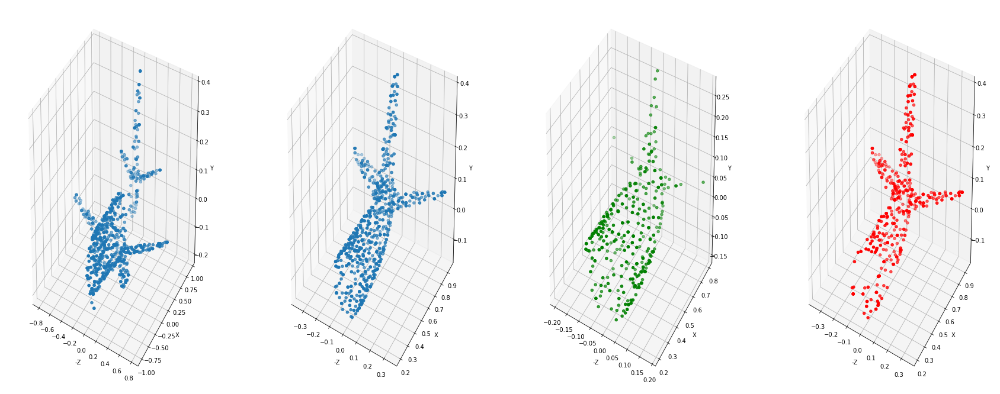

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

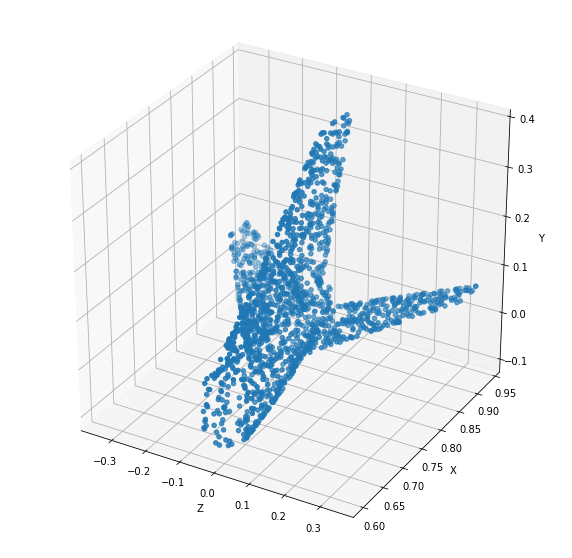

In [ ]:
2#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.3.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.410914
1,1,1,0.701066
2,2,2,0.701066
3,3,3,0.121938
4,4,4,0.701066
...,...,...,...
1019,1019,1019,0.386074
1020,1020,1020,0.569523
1021,1021,1021,0.497543
1022,1022,1022,0.663057


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.125
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

212

In [ ]:
len(diferentes)

812

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

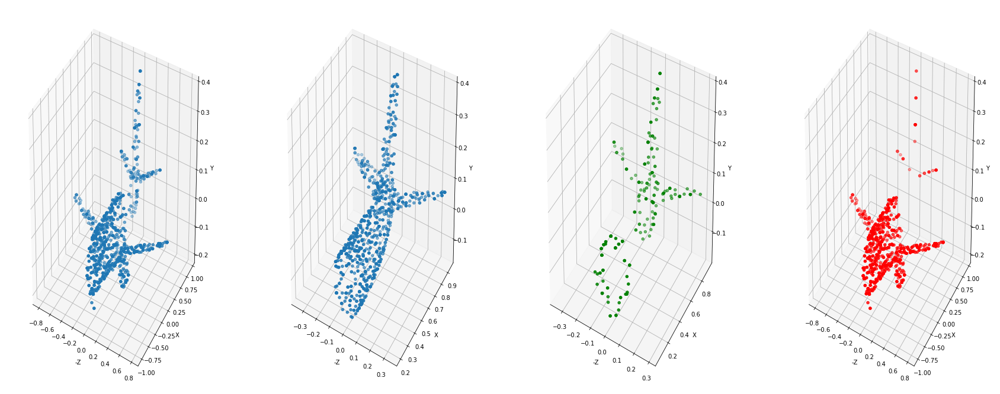

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

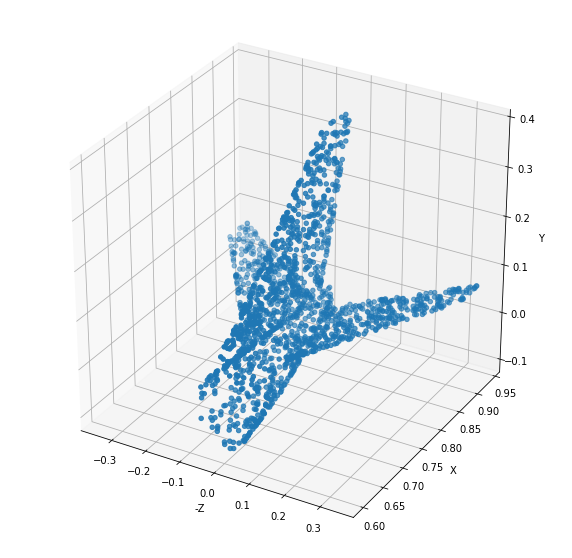

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####Vecino más cercano

In [ ]:
#Ambos tienen la misma cantidad de puntos porque los filtré luego de diseccionar la nube de puntos
print(pcA.shape)
print(pcB.shape)

(1024, 3)
(1024, 3)


In [ ]:
#Hallo los indices de los puntos que son candidatos a puntos de anclaje
distEuclidA, indicesA = nearest_neighbor(pcA, pcB)
distEuclidB, indicesB = nearest_neighbor(pcB, pcA)

In [ ]:
zonaA = pcA[indicesA]
zonaB = pcB[indicesB]

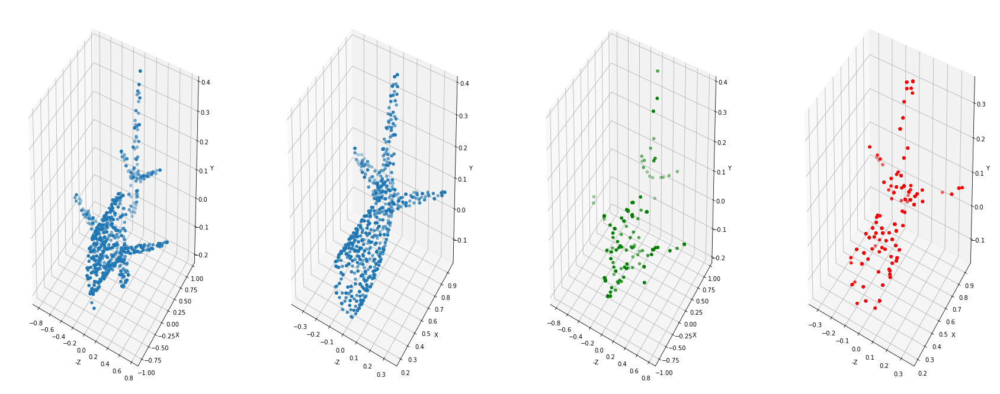

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = zonaA[:,0]
Y = zonaA [:,1]
Z = zonaA[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = zonaB[:,0]
Y = zonaB [:,1]
Z = zonaB[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

#1. Radio

##Cargar modelo

In [ ]:
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/')

ptts = np.loadtxt('./data/radio/radio_0003.txt', delimiter=',', usecols=(0,1,2))
#ptts = ptts[:1000]

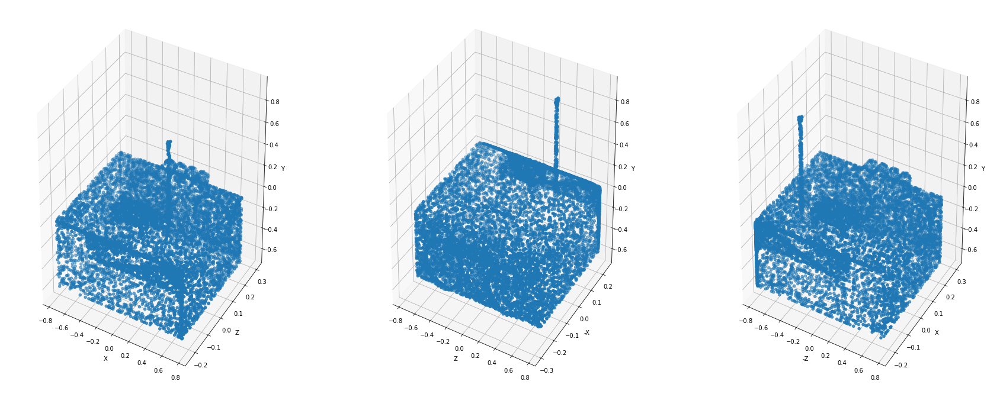

In [ ]:
fig = plt.figure(figsize=(30,12))


ax = fig.add_subplot(1, 3, 1, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 3, 2, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax.scatter3D(Z,-X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('-X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 3, 3, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

plt.show()

##1.1 Primer segmento, todo diferente menos la cabina, con divisiones irregulares

In [ ]:
ptts[i]

array([ 0.2361, -0.1828,  0.1851])

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if (ptts[i][0]>-0.1 and ptts[i][0]<0) or (ptts[i][0]>0.1 and ptts[i][0]<0.2):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0]<-0.1):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

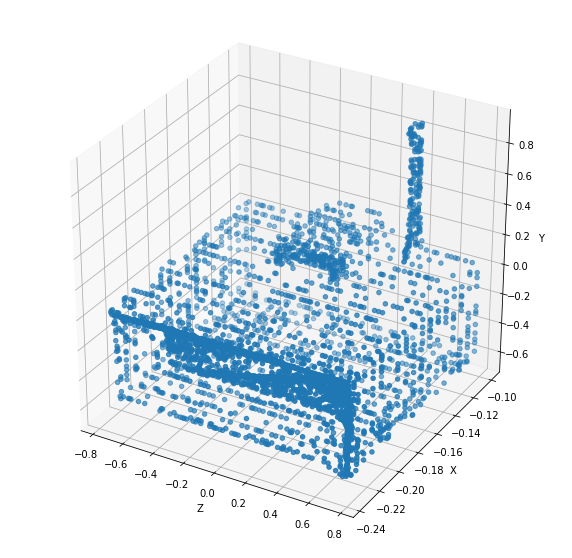

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

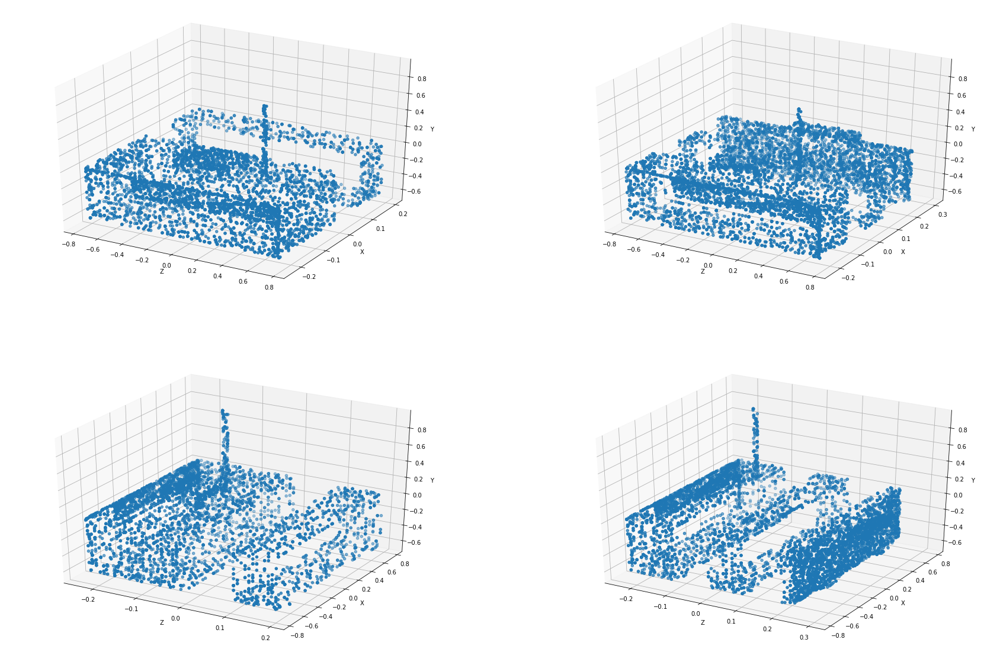

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

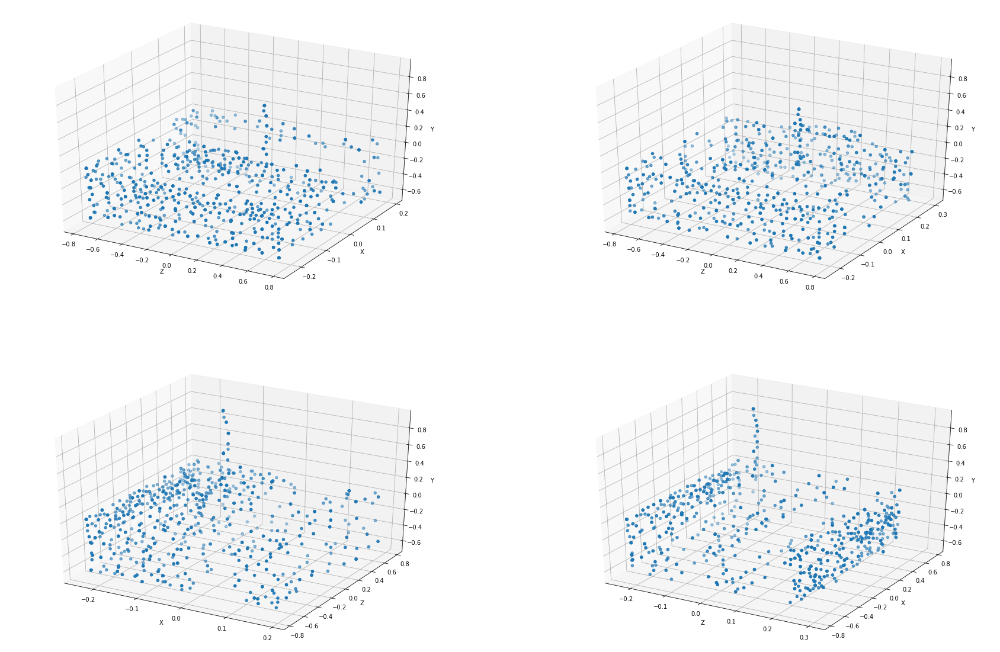

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.1.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.279716
1,1,1,0.279716
2,2,2,0.042991
3,3,3,0.064311
4,4,4,0.042991
...,...,...,...
1019,1019,1019,0.082784
1020,1020,1020,0.080722
1021,1021,1021,0.198788
1022,1022,1022,0.042459


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00000001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

461

In [ ]:
len(diferentes)

563

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

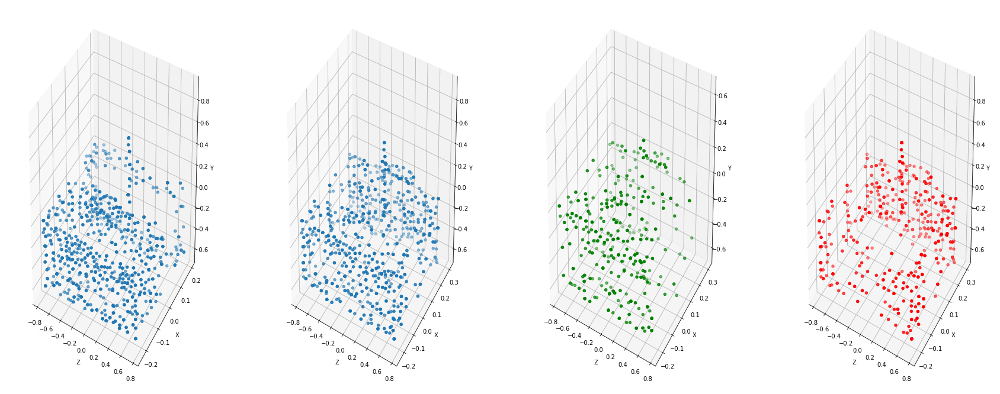

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(Z,X,Y, c='green')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(Z,X,Y, c='red')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

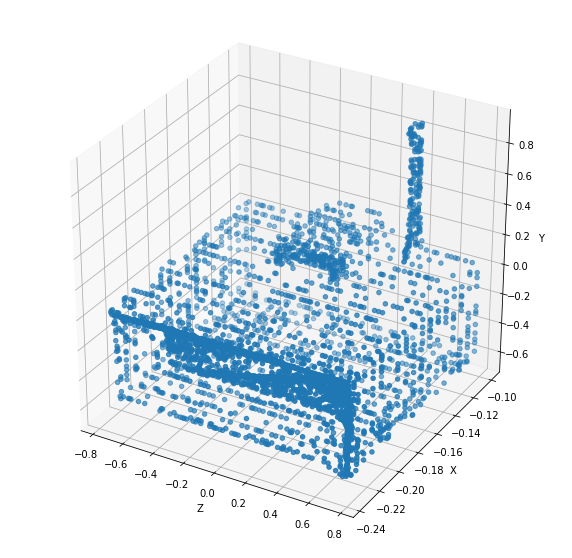

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.1.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.068004
1,1,1,0.068004
2,2,2,0.068004
3,3,3,0.039990
4,4,4,0.044966
...,...,...,...
1019,1019,1019,0.000000
1020,1020,1020,0.000000
1021,1021,1021,0.039274
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.0001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

641

In [ ]:
len(diferentes)

383

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

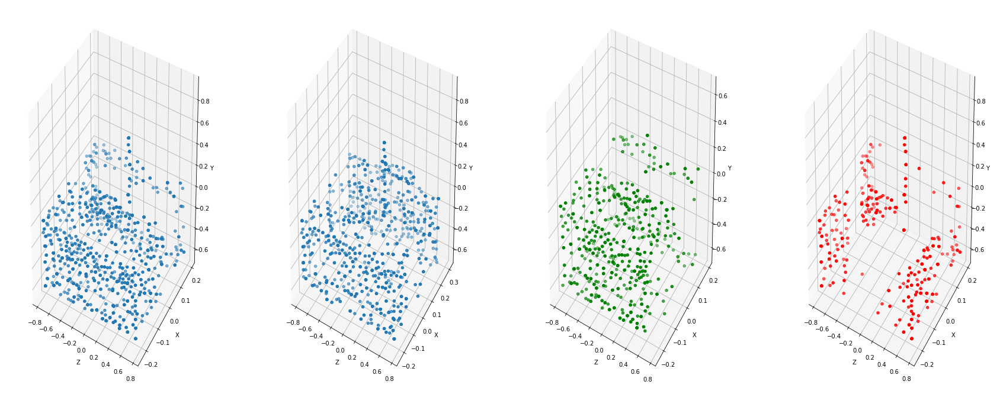

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(Z,X,Y, c='green')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(Z,X,Y, c='red')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

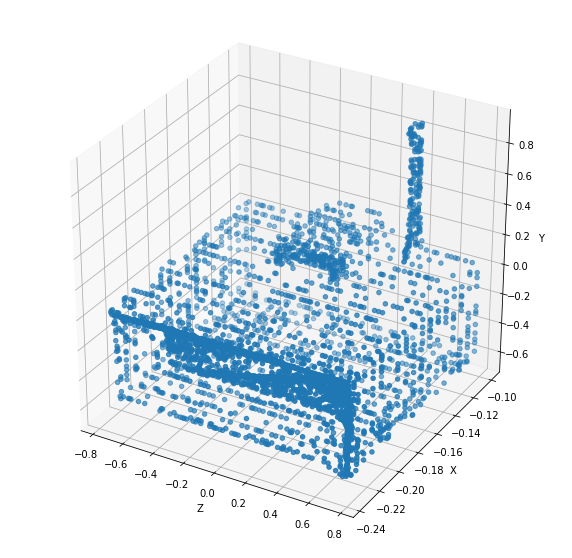

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

##1.2 Segundo Segmento, Modelo dividido en dos con areas en común en la mitad

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0) and (ptts[i][0] < 0.1):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

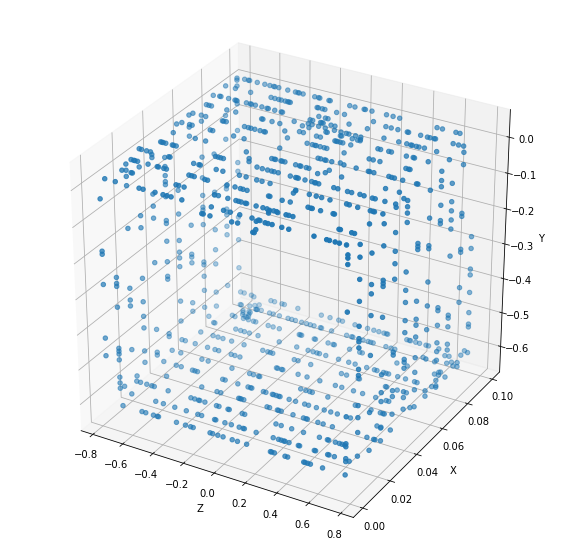

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

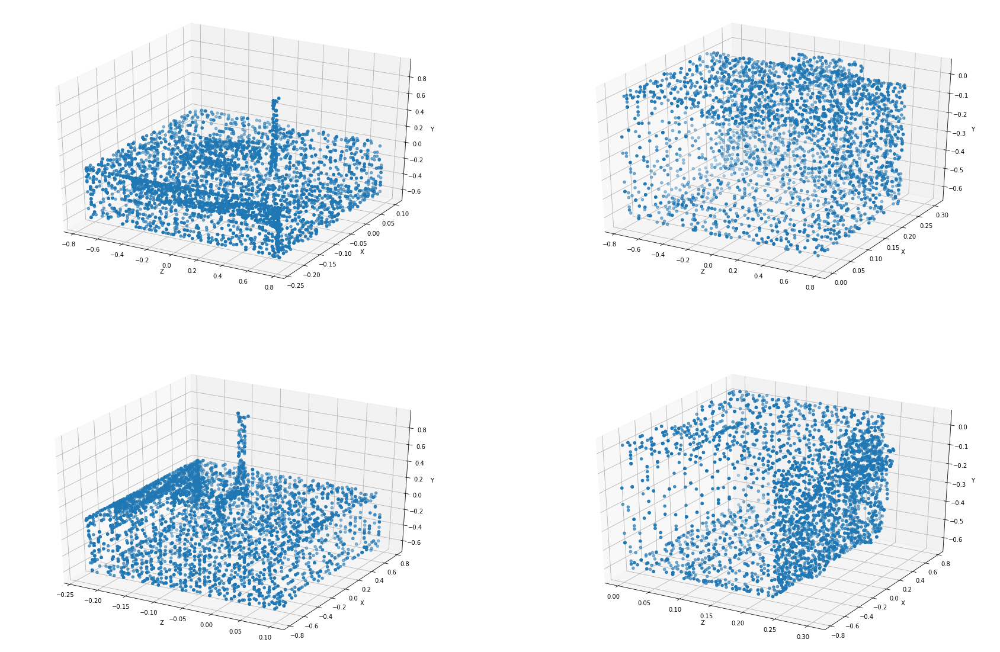

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

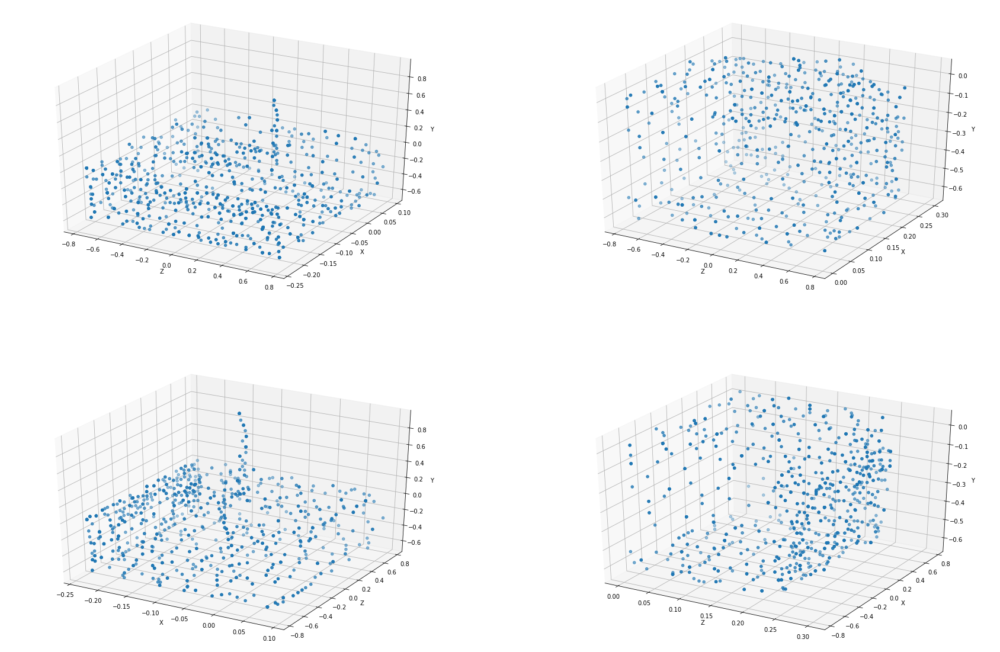

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.2.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.239939
1,1,1,0.239939
2,2,2,0.000000
3,3,3,0.000000
4,4,4,0.163531
...,...,...,...
1019,1019,1019,0.267945
1020,1020,1020,0.312874
1021,1021,1021,0.121720
1022,1022,1022,0.153545


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.0000000001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

236

In [ ]:
len(diferentes)

788

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

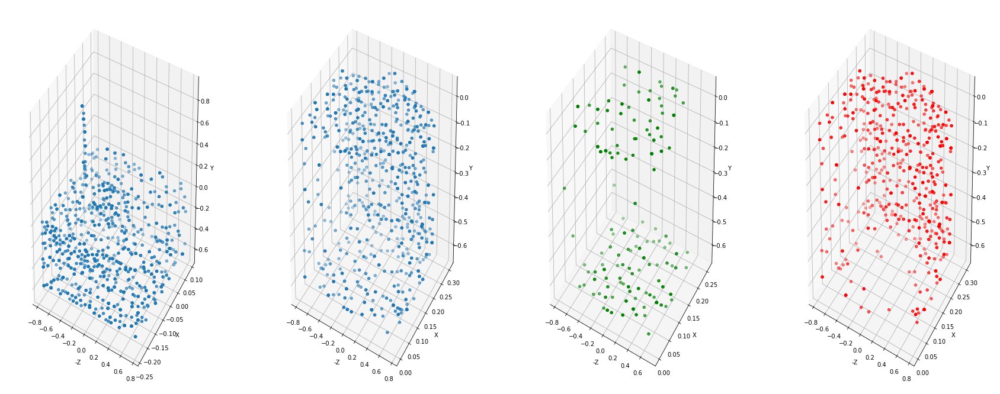

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

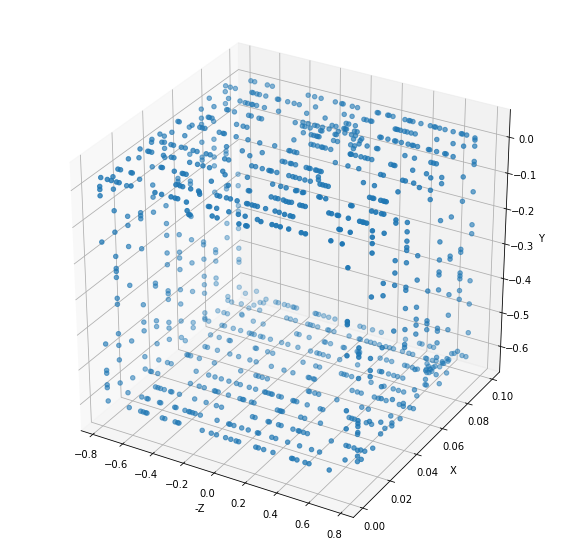

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.2.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.897087
1,1,1,0.349141
2,2,2,0.897087
3,3,3,0.324728
4,4,4,0.349141
...,...,...,...
1019,1019,1019,0.260478
1020,1020,1020,0.070315
1021,1021,1021,0.087545
1022,1022,1022,0.212568


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.01
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

200

In [ ]:
len(diferentes)

824

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

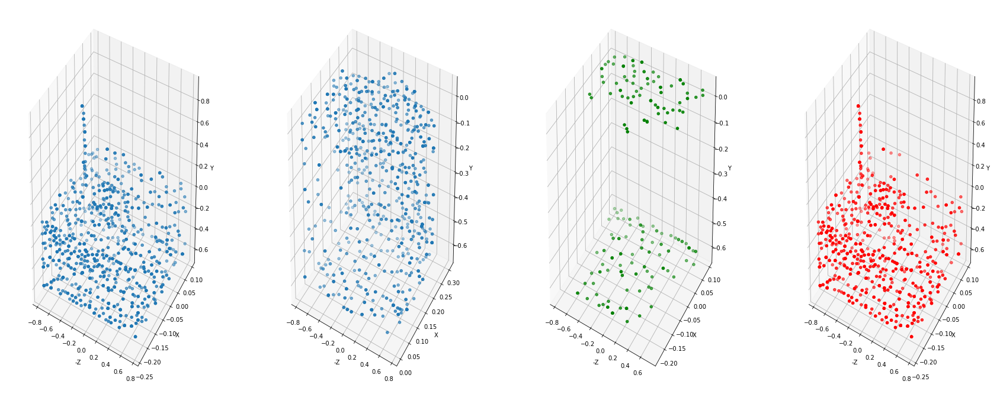

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

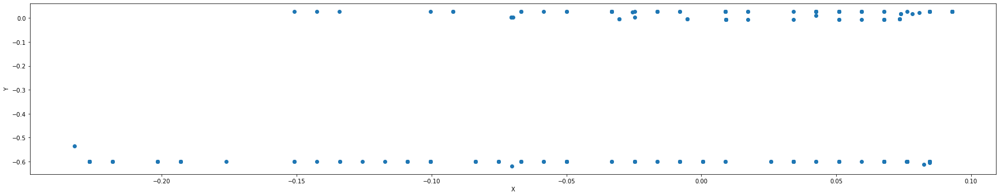

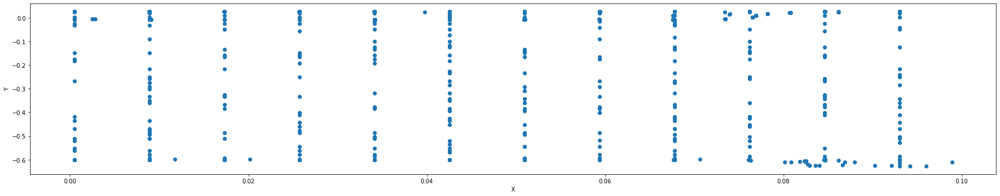

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(2, 1, 1)

X = sim[:,0]
Y = sim [:,1]

ax.scatter(X,Y)
ax.set_xlabel('X')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(2, 1, 2)
X = inteseccion[:,0]
Y = inteseccion [:,1]
ax.scatter(X,Y)
ax.set_xlabel('X')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

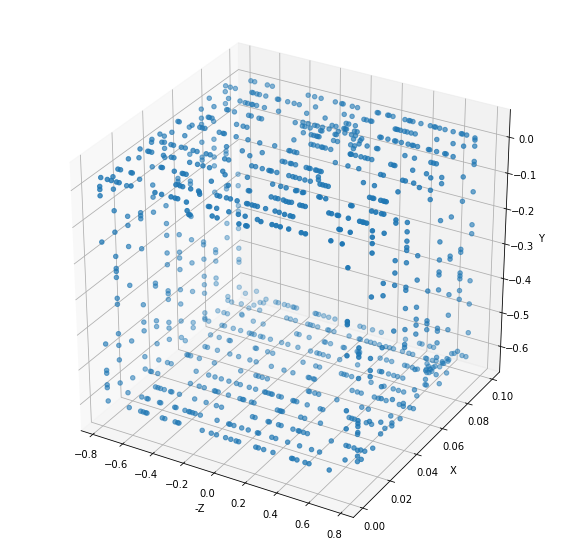

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

##1.3 Tercer Segmento, Modelo dividido en dos con areas en común en la cola

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0.2):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

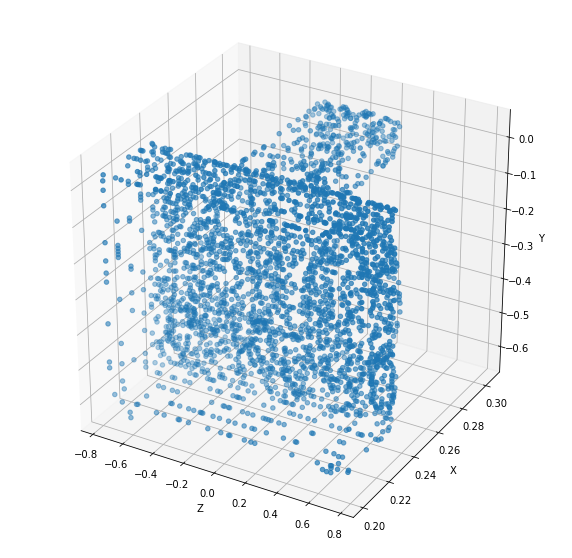

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

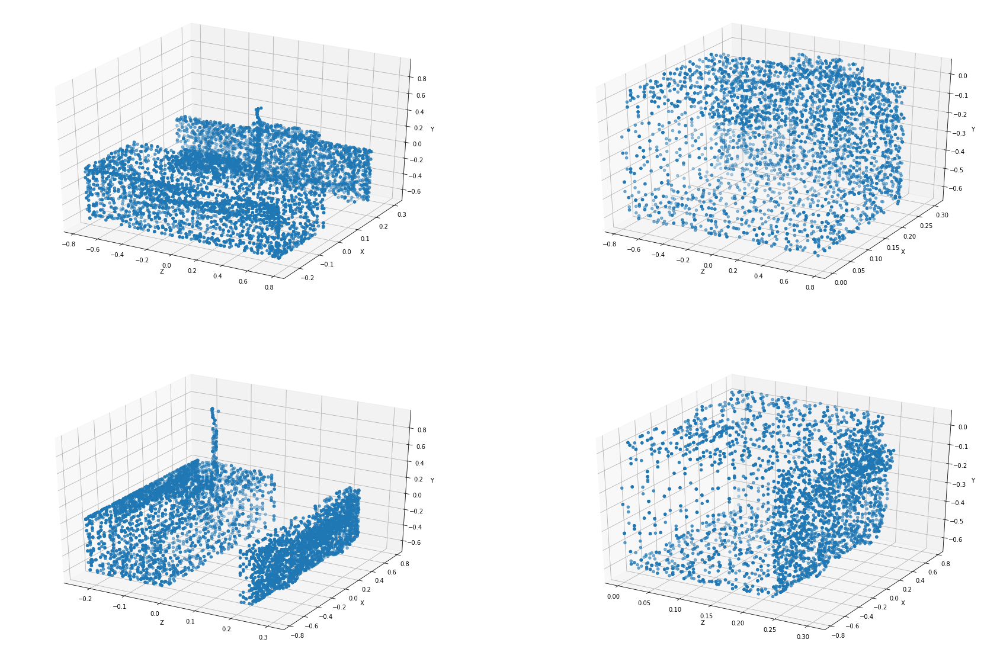

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

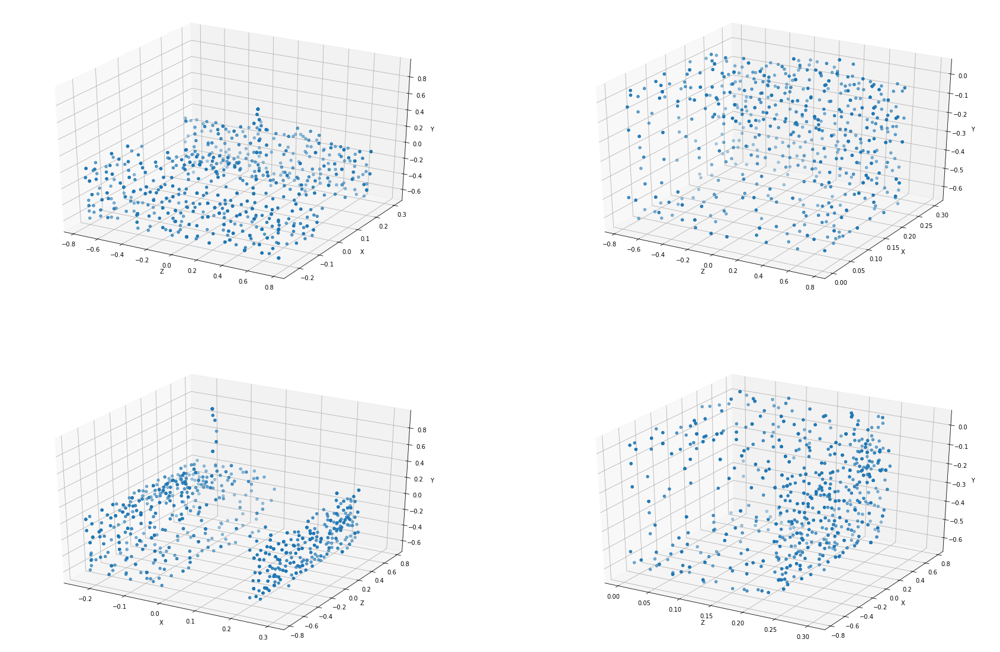

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.3.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.021691
1,1,1,0.000000
2,2,2,0.000000
3,3,3,0.028933
4,4,4,0.000000
...,...,...,...
1019,1019,1019,0.000000
1020,1020,1020,0.000000
1021,1021,1021,0.093969
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

694

In [ ]:
len(diferentes)

330

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

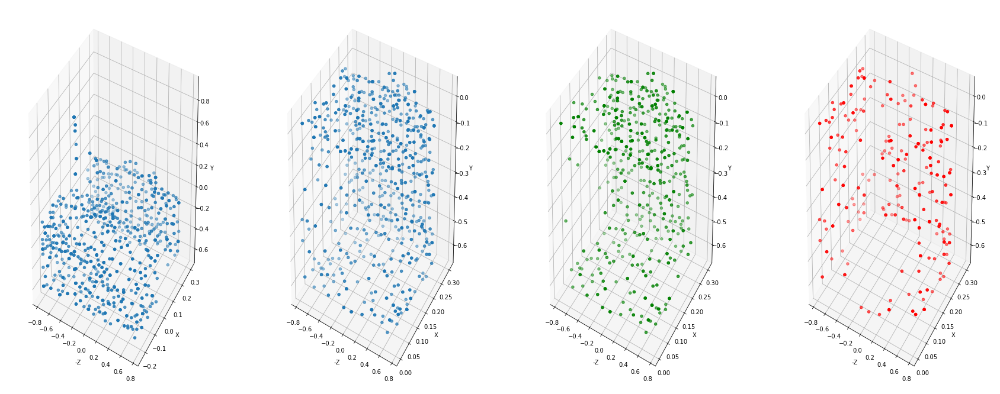

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

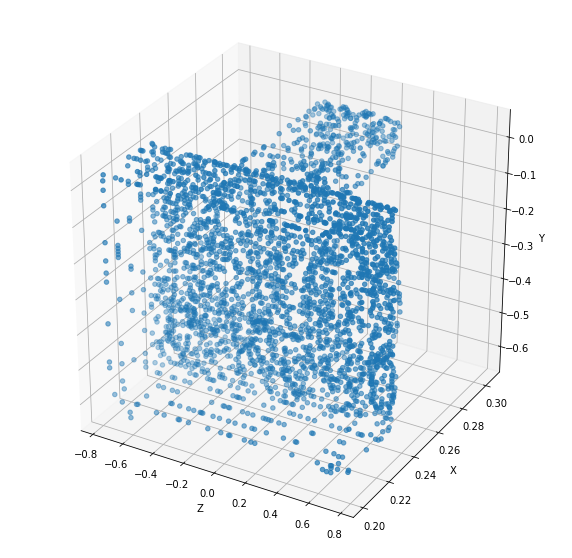

In [ ]:
2#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.3.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.000000
1,1,1,0.962393
2,2,2,0.000000
3,3,3,0.325129
4,4,4,0.962393
...,...,...,...
1019,1019,1019,0.032462
1020,1020,1020,0.000000
1021,1021,1021,0.183738
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.125
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

571

In [ ]:
len(diferentes)

453

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

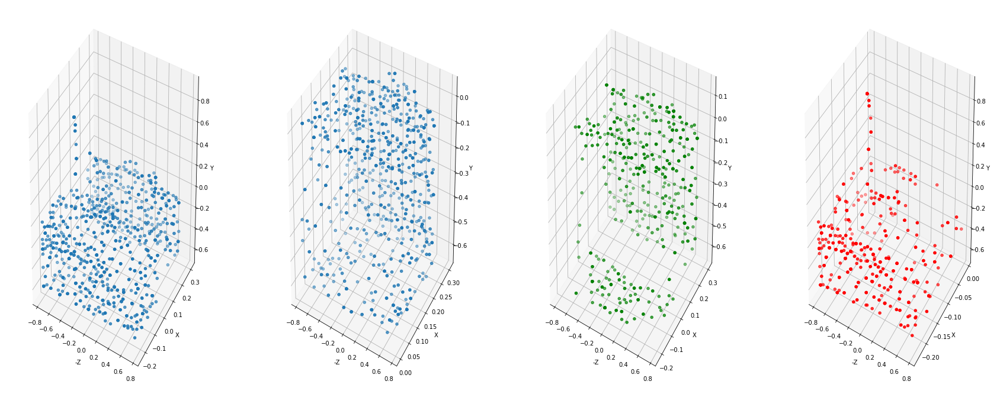

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

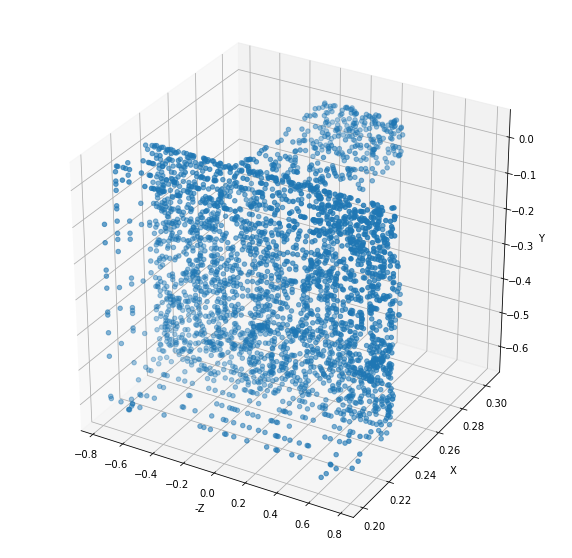

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

#1. Conejo

##Cargar modelo

In [ ]:
!pip install plyfile

In [ ]:
os.chdir('/content/drive/MyDrive/PROYECTO DE GRADO/Code')
from plyfile import PlyData, PlyElement #Libreria para almacenar datos tridimensionales de escáneres 3D.

In [ ]:
plydata = PlyData.read('Data/bunny/reconstruction/bun_zipper_res2.ply')

Extraemos solo las coordenadas en X, Y y Z del conejito

In [ ]:
points = []
for point in plydata.elements[0].data:
    points.append([point['x'], point['y'], point['z']])
points = np.array(points)

In [ ]:
ptts = points-np.mean(points,0)

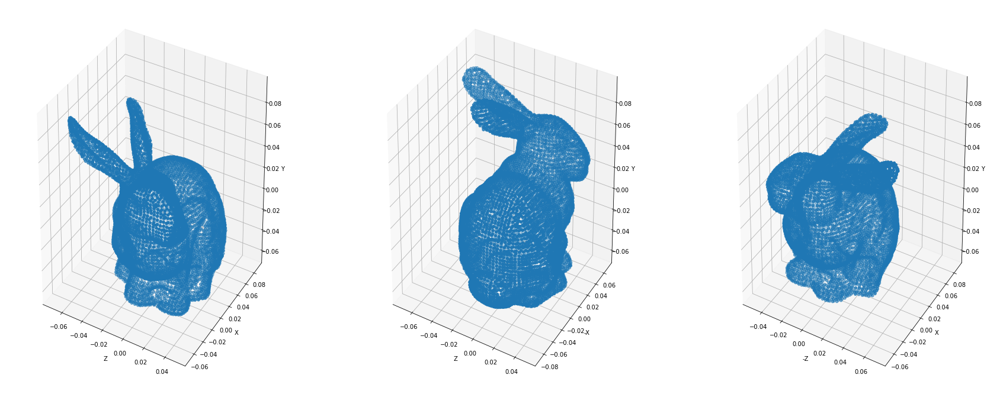

In [ ]:
fig = plt.figure(figsize=(30,12))


ax = fig.add_subplot(1, 3, 1, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 3, 2, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax.scatter3D(Z,-X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('-X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 3, 3, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

plt.show()

##1.1 Primer segmento, todo diferente menos la cabina, con divisiones irregulares

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if (ptts[i][0]>-0.02 and ptts[i][0]<0) or (ptts[i][0]>0.04 and ptts[i][0]<0.06):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0]<-0.02):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

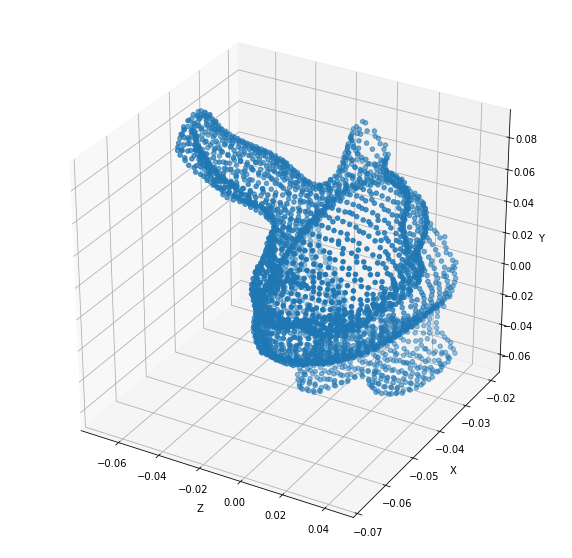

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

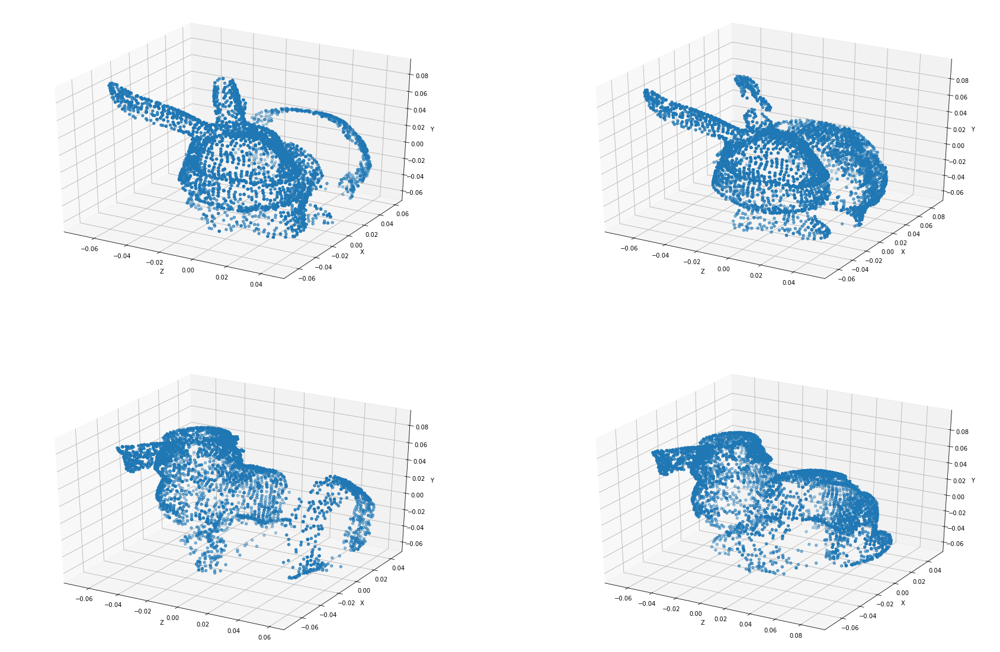

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

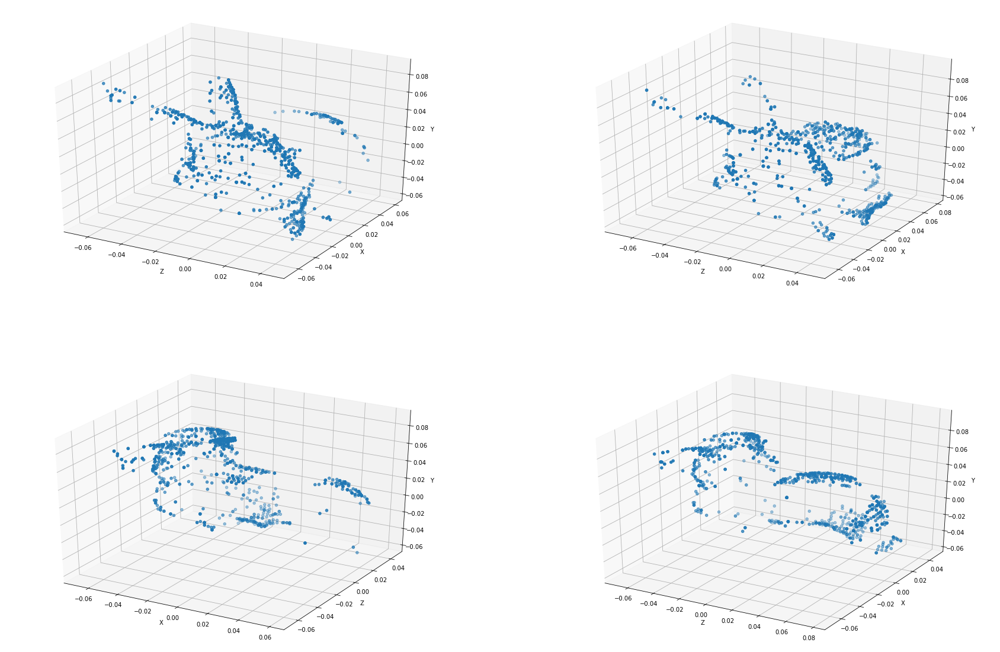

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.1.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.012430
1,1,1,0.012430
2,2,2,0.078001
3,3,3,0.010775
4,4,4,0.011632
...,...,...,...
1019,1019,1019,0.071220
1020,1020,1020,0.017429
1021,1021,1021,0.053180
1022,1022,1022,0.027630


In [ ]:
similaresB=[]
diferentesB=[]
simB = []
difB = []
rango = 0.00001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similaresB.append(m['m_punto_pcB'][i])
    simB.append(pcB[i])
  else:
    diferentesB.append(m['m_punto_pcB'][i])
    difB.append(pcB[i])

In [ ]:
len(similaresB)

193

In [ ]:
len(diferentesB)

831

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similaresB)):
    if(similaresB[j]==i):
      dst = distance.euclidean(pcA[similaresB[j]], pcB[similaresB[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
difB = np.array(difB)
simB = np.array(simB)

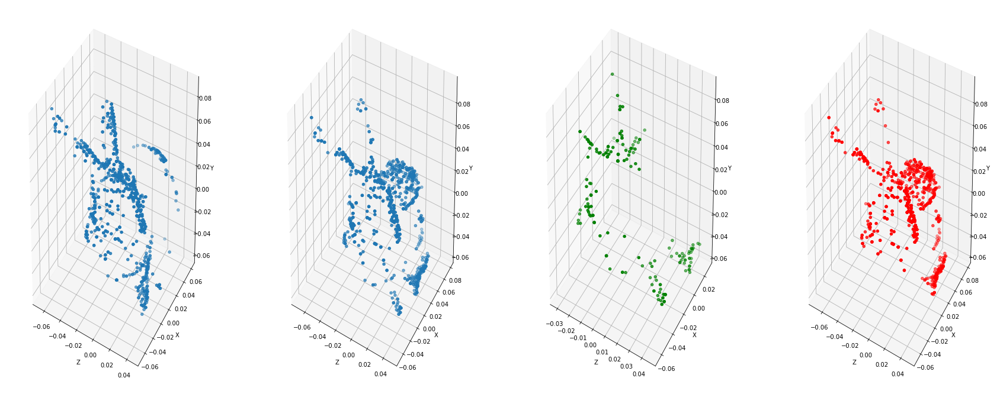

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = simB[:,0]
Y = simB [:,1]
Z = simB[:,2]
ax.scatter3D(Z,X,Y, c='green')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = difB[:,0]
Y = difB [:,1]
Z = difB[:,2]
ax.scatter3D(Z,X,Y, c='red')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.08195857900663273, 0.010980367528814677, 'Y')

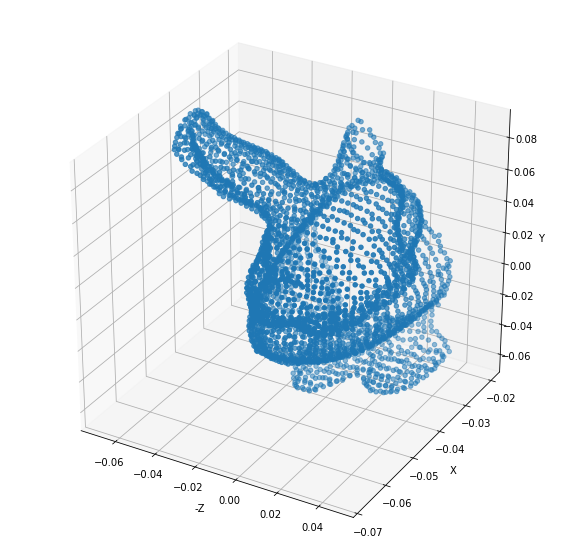

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax1 = fig.add_subplot(1, 1, 1, projection='3d', sharex=ax, sharey=ax)
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax1.scatter3D(Z,X,Y)
ax1.set_xlabel('-Z')
ax1.set_ylabel('X')
ax1.set_zlabel('Y')

####1.1.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.000000
1,1,1,0.000000
2,2,2,0.000000
3,3,3,0.038438
4,4,4,0.070789
...,...,...,...
1019,1019,1019,0.002803
1020,1020,1020,0.036317
1021,1021,1021,0.032606
1022,1022,1022,0.000000


In [ ]:
similaresA=[]
diferentesA=[]
simA = []
difA = []
rango = 0.00001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similaresA.append(m['n_punto_pcA'][i])
    simA.append(pcA[i])
  else:
    diferentesA.append(m['n_punto_pcA'][i])
    difA.append(pcA[i])

In [ ]:
len(similaresA)

354

In [ ]:
len(diferentesA)

670

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similaresA)):
    if(similaresA[j]==i):
      dst = distance.euclidean(pcA[similaresA[j]], pcB[similaresA[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
difA = np.array(difA)
simA = np.array(simA)

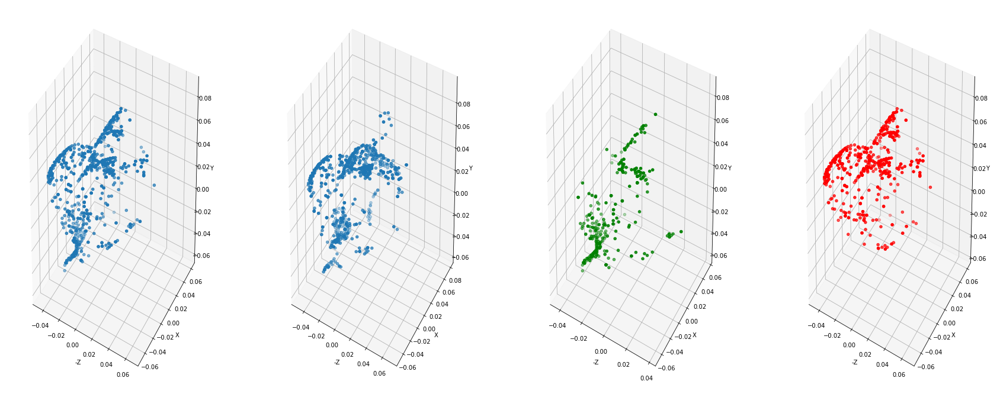

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = simA[:,0]
Y = simA [:,1]
Z = simA[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = difA[:,0]
Y = difA [:,1]
Z = difA[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

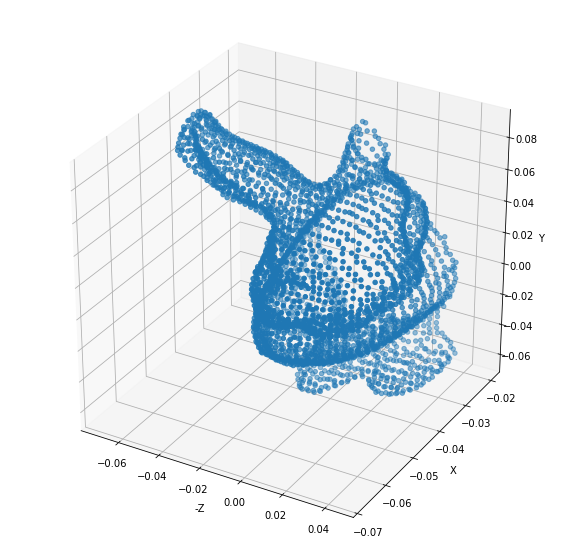

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####Coincidentes

In [ ]:
coincidentesIndices = p_coincidentes_PcAyPcB(similaresA, similaresB)

print(len(coincidentesIndices))

coincidentesNube = []
coincidentesA = []
coincidentesB = []
for x in coincidentesIndices:
  coincidentesNube.append(ptts[x])
  coincidentesA.append(nubeA[x])
  coincidentesB.append(nubeB[x])

coincidentesNube = np.array(coincidentesNube)
coincidentesA = np.array(coincidentesA)
coincidentesB = np.array(coincidentesB)

31


Text(0.5, 0, 'Y')

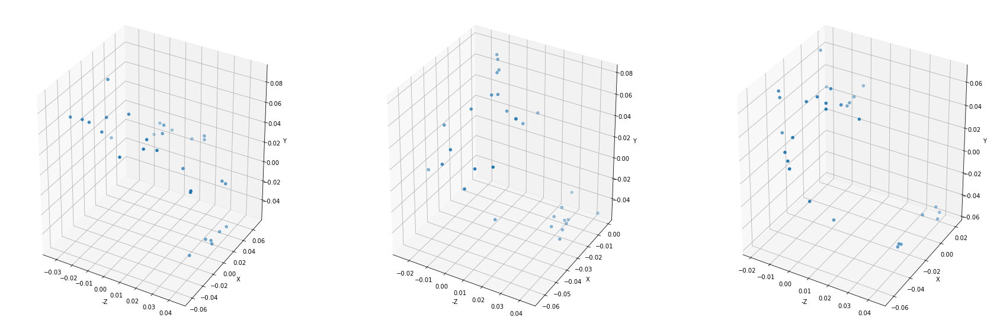

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(30,10))

ax = fig.add_subplot(1, 3, 1, projection='3d')
X = coincidentesNube[:,0]
Y = coincidentesNube[:,1]
Z = coincidentesNube[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(1, 3, 2, projection='3d')
X = coincidentesA[:,0]
Y = coincidentesA[:,1]
Z = coincidentesA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(1, 3, 3, projection='3d')
X = coincidentesB[:,0]
Y = coincidentesB[:,1]
Z = coincidentesB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

##1.2 Segundo Segmento, Modelo dividido en dos con areas en común en la mitad

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0) and (ptts[i][0] < 0.02):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

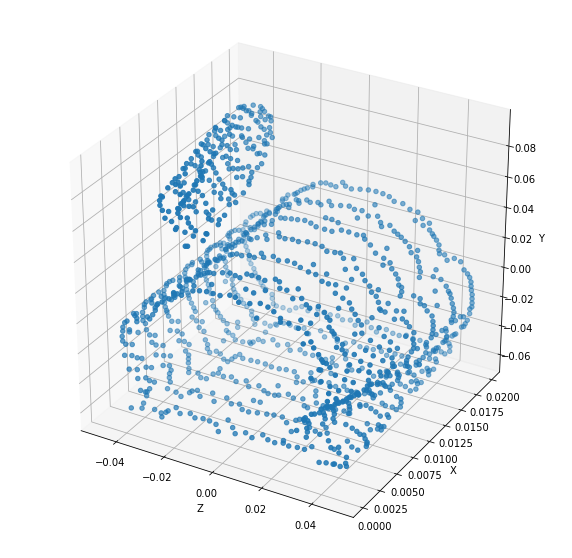

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

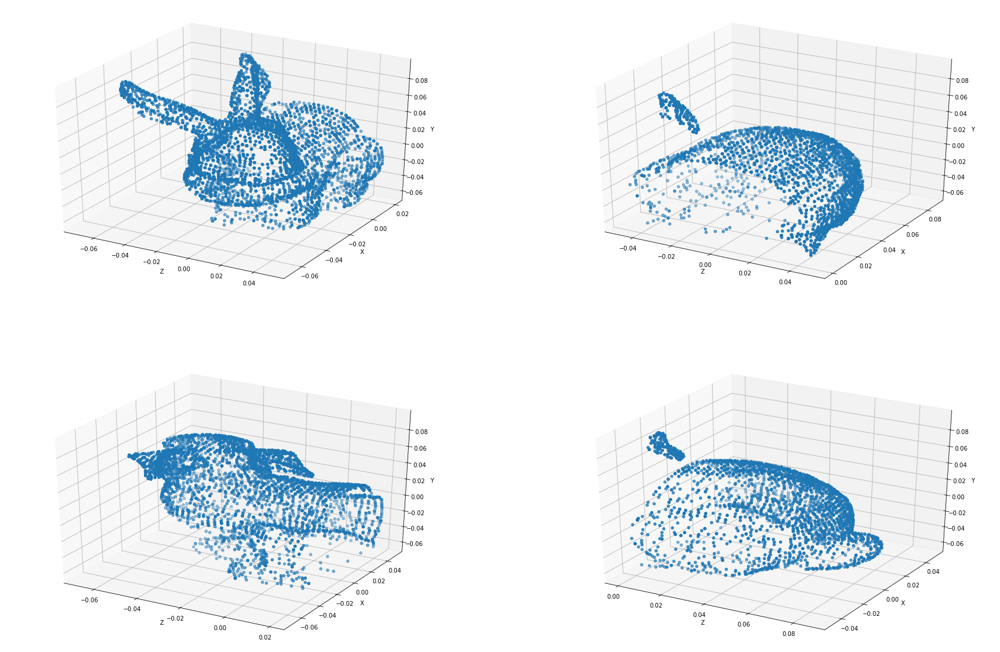

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

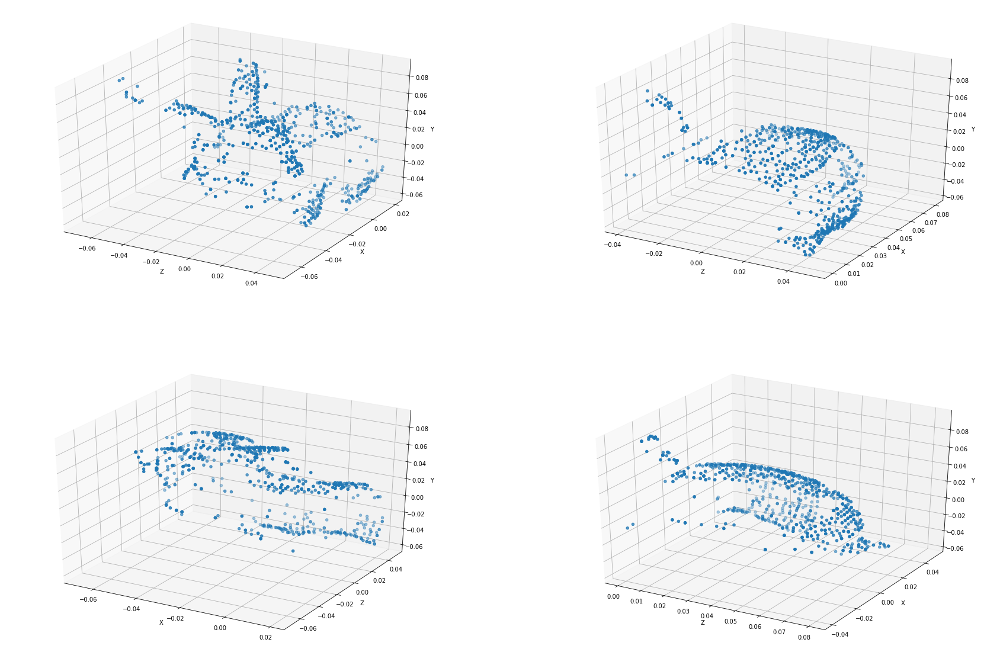

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.2.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.110214
1,1,1,0.110214
2,2,2,0.000000
3,3,3,0.110214
4,4,4,0.110214
...,...,...,...
1019,1019,1019,0.020827
1020,1020,1020,0.060538
1021,1021,1021,0.024103
1022,1022,1022,0.034341


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.05
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

347

In [ ]:
len(diferentes)

677

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

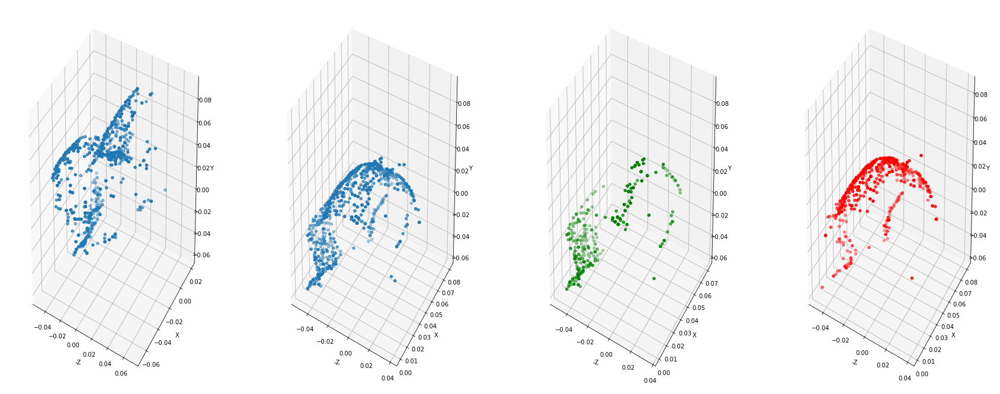

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif[:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

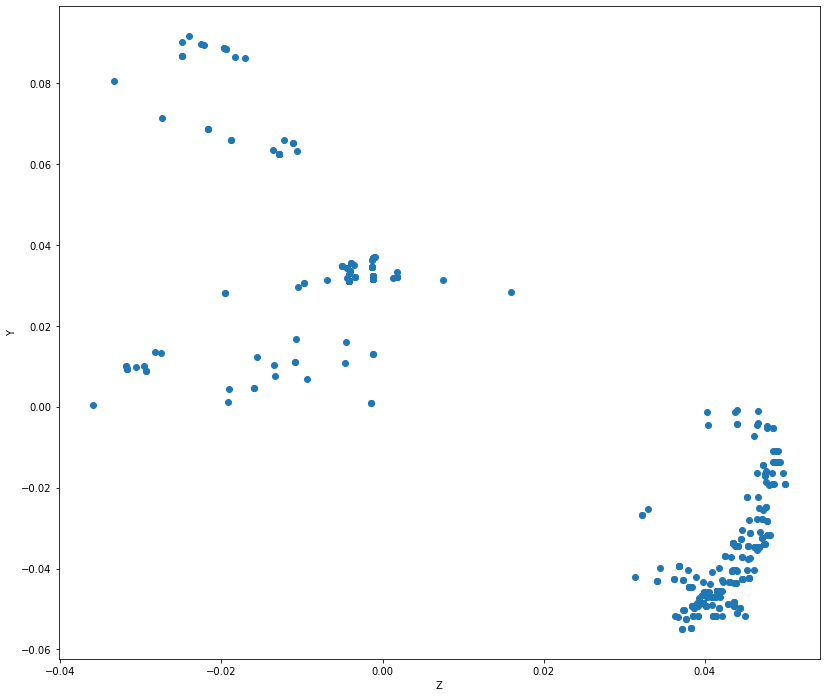

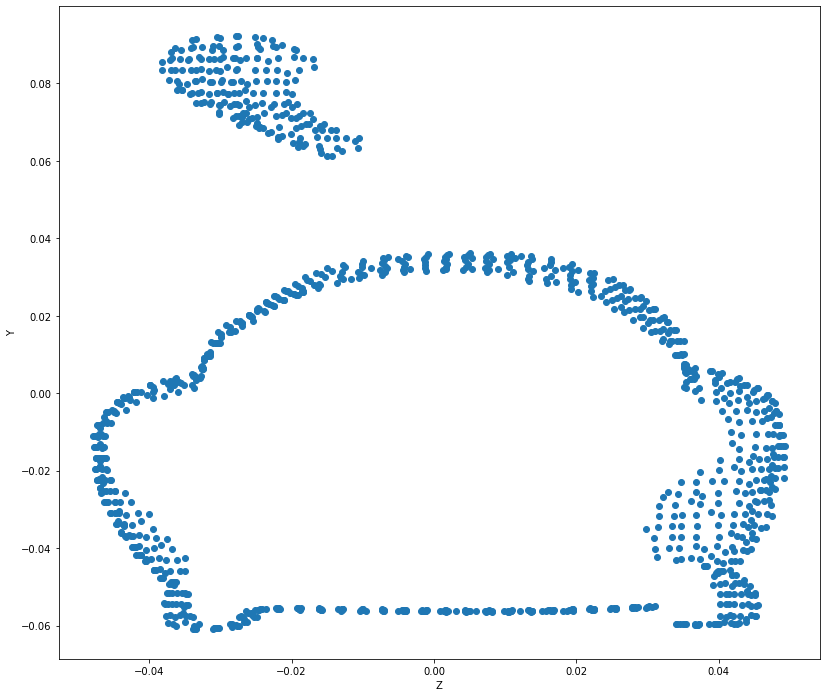

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1)
Y = sim [:,1]
Z = sim[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 2)
Y = inteseccion[:,1]
Z = inteseccion[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

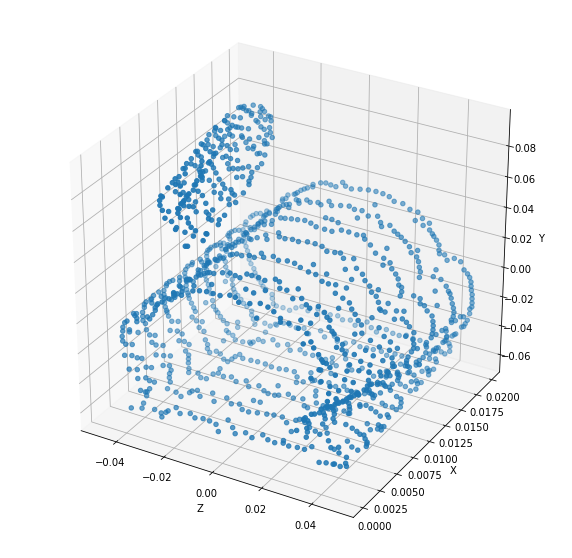

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.2.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.074229
1,1,1,0.079426
2,2,2,0.079426
3,3,3,0.093169
4,4,4,0.093169
...,...,...,...
1019,1019,1019,0.090531
1020,1020,1020,0.054125
1021,1021,1021,0.073608
1022,1022,1022,0.029814


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

30

In [ ]:
len(diferentes)

994

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

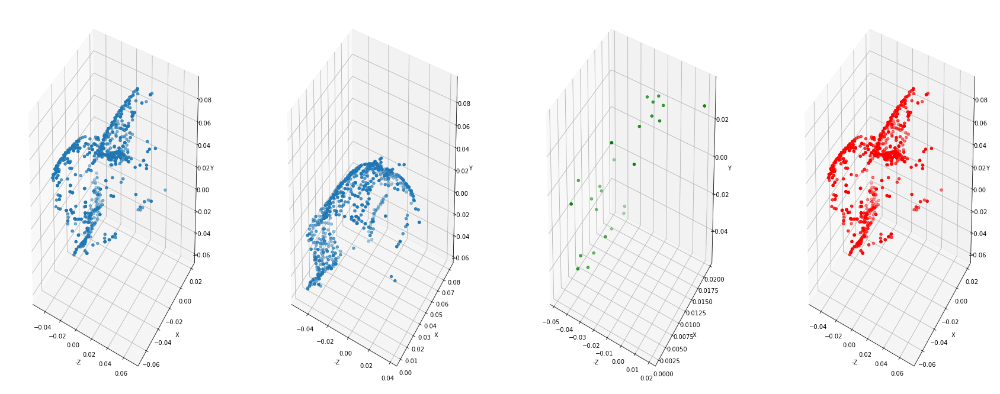

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

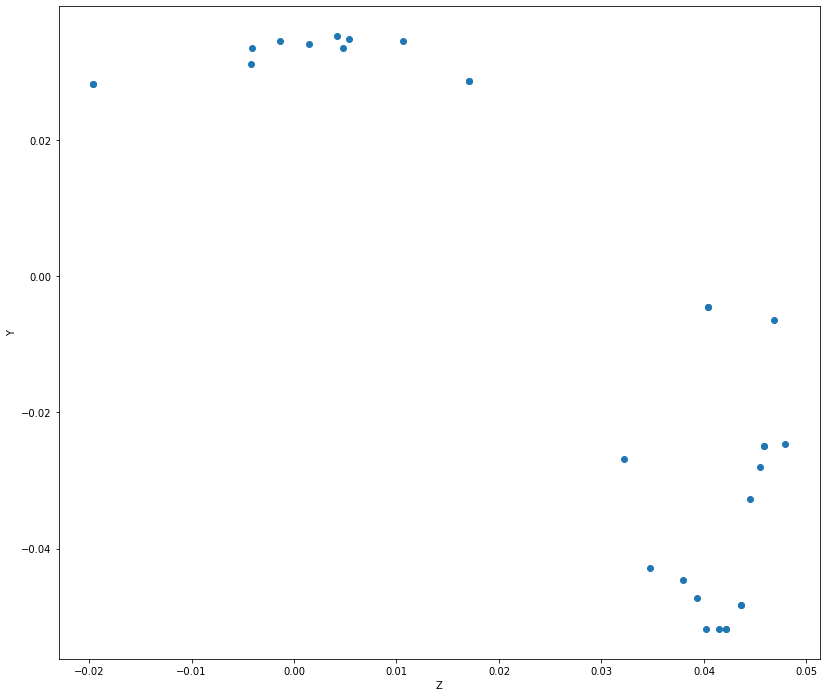

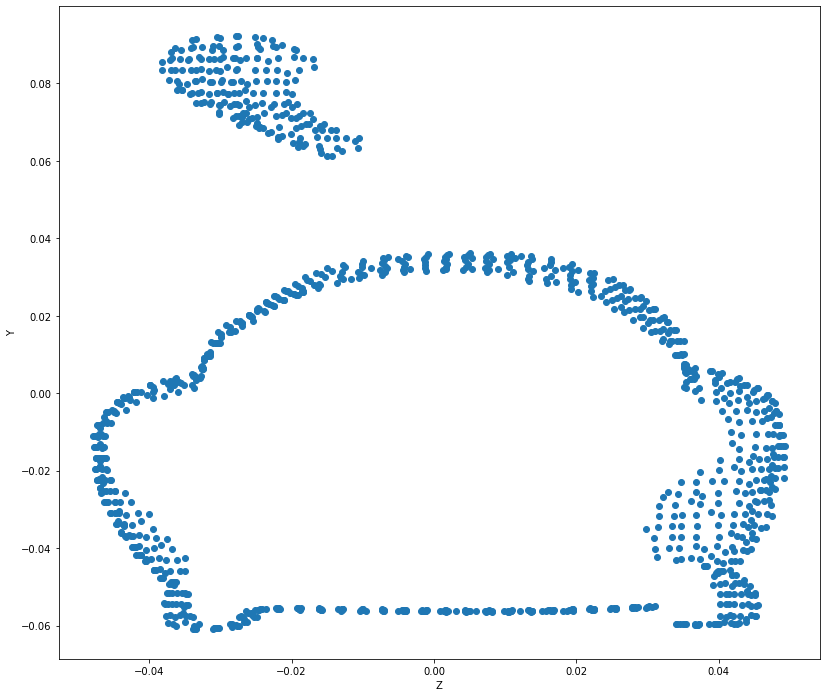

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1)
Y = sim [:,1]
Z = sim[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 2)
Y = inteseccion[:,1]
Z = inteseccion[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

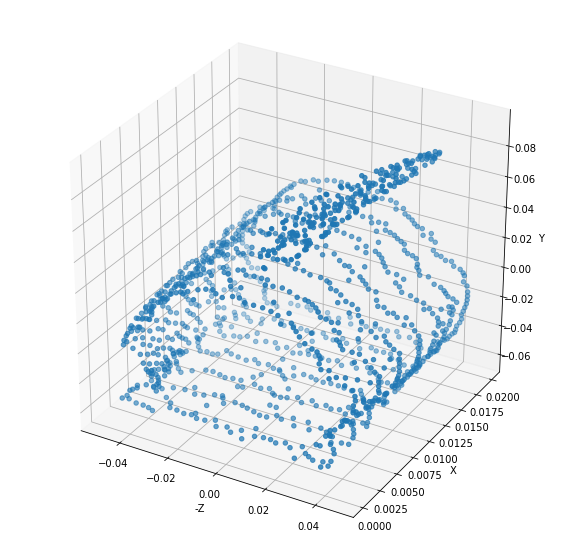

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

##1.3 Tercer Segmento, Modelo dividido en dos con areas en común en la cola

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0.06):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

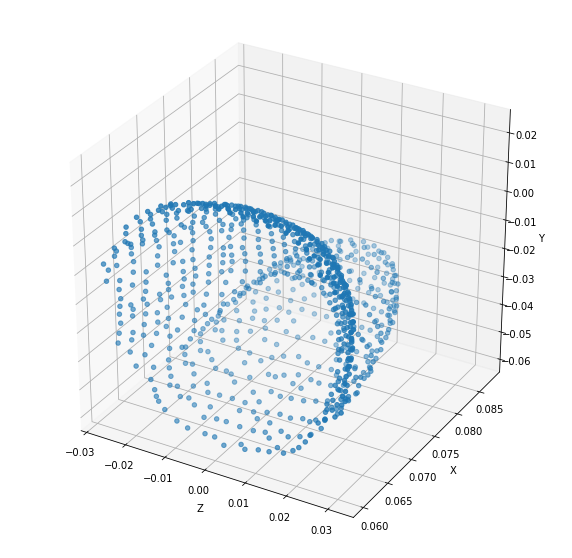

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

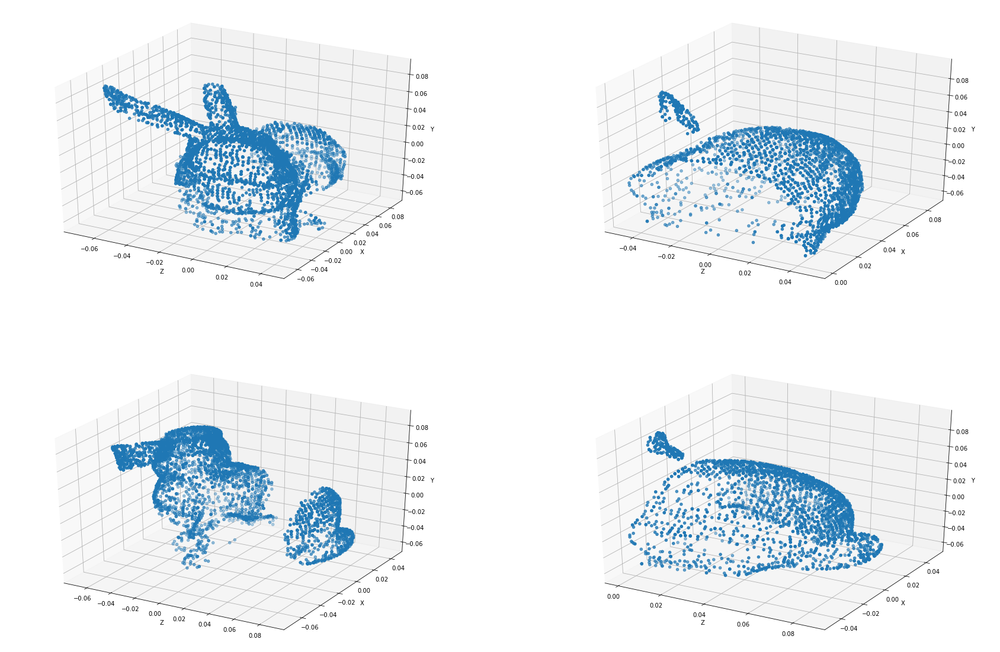

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

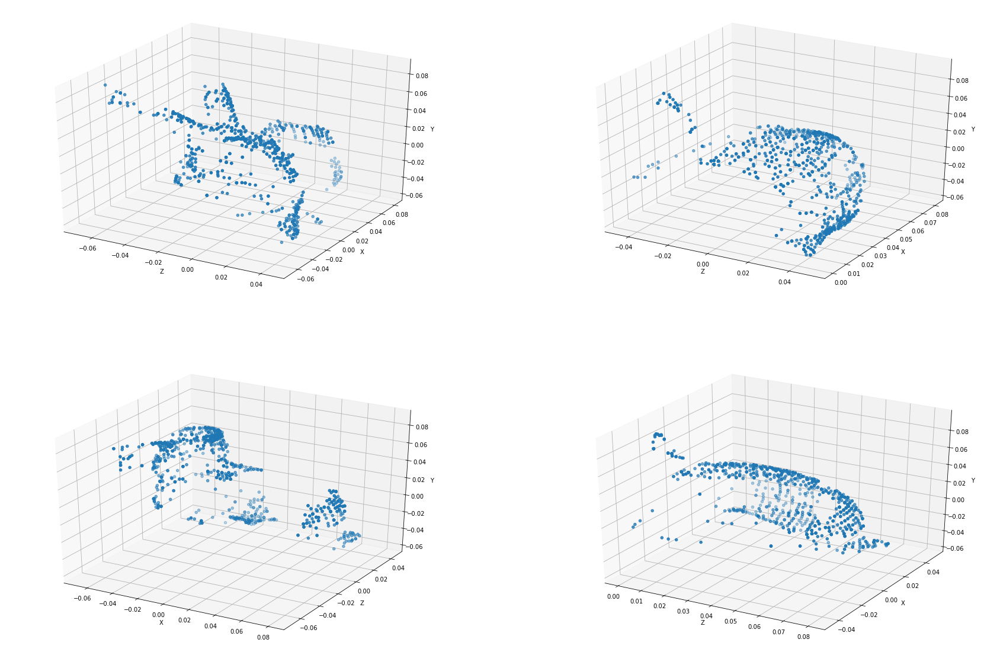

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.3.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.087968
1,1,1,0.026337
2,2,2,0.025544
3,3,3,0.097725
4,4,4,0.087968
...,...,...,...
1019,1019,1019,0.066690
1020,1020,1020,0.050003
1021,1021,1021,0.072686
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

220

In [ ]:
len(diferentes)

804

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

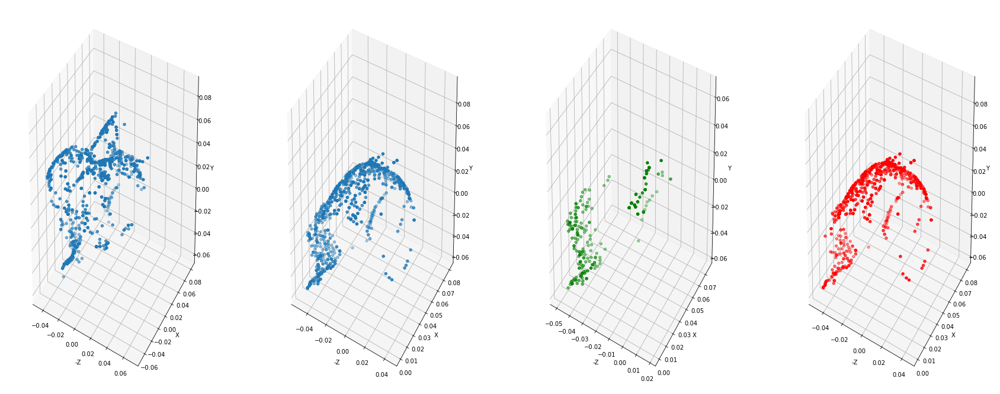

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

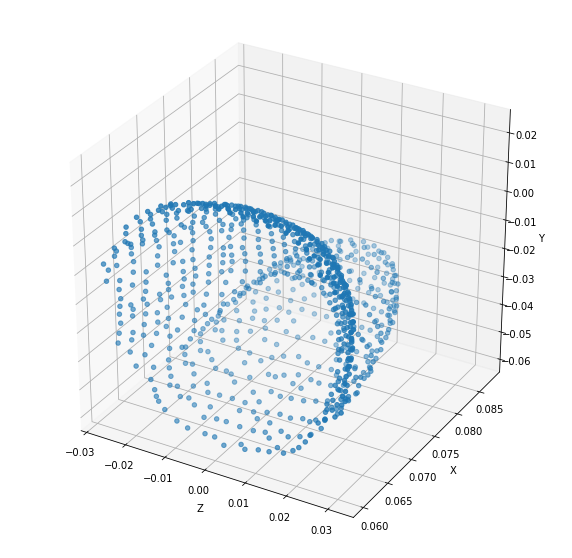

In [ ]:
2#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.3.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.071634
1,1,1,0.071634
2,2,2,0.079045
3,3,3,0.071634
4,4,4,0.079045
...,...,...,...
1019,1019,1019,0.089930
1020,1020,1020,0.087948
1021,1021,1021,0.062667
1022,1022,1022,0.074608


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.05
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

199

In [ ]:
len(diferentes)

825

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

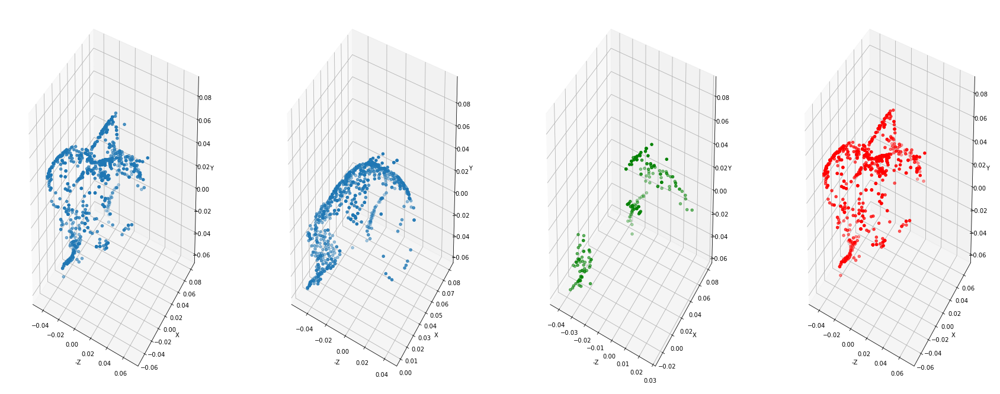

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

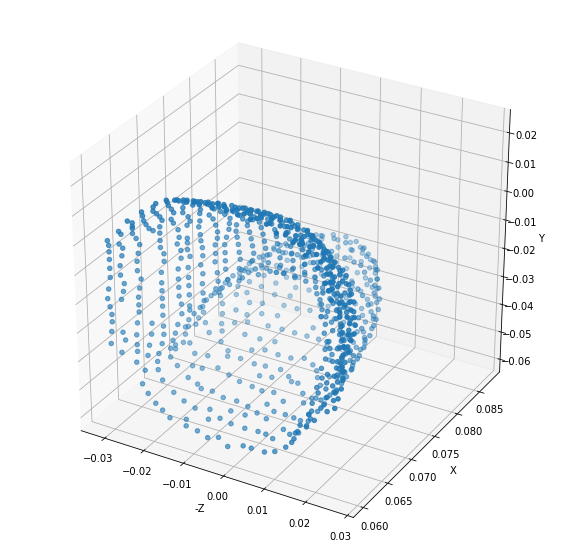

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

#Toilet

##Cargar modelo

In [ ]:
os.chdir('/content/drive/MyDrive/Proyecto de grado-Extensión/Registro de Nubes/')

ptts = np.loadtxt('./data/toilet/toilet_0001.txt', delimiter=',', usecols=(0,1,2))
#ptts = ptts[:1000]

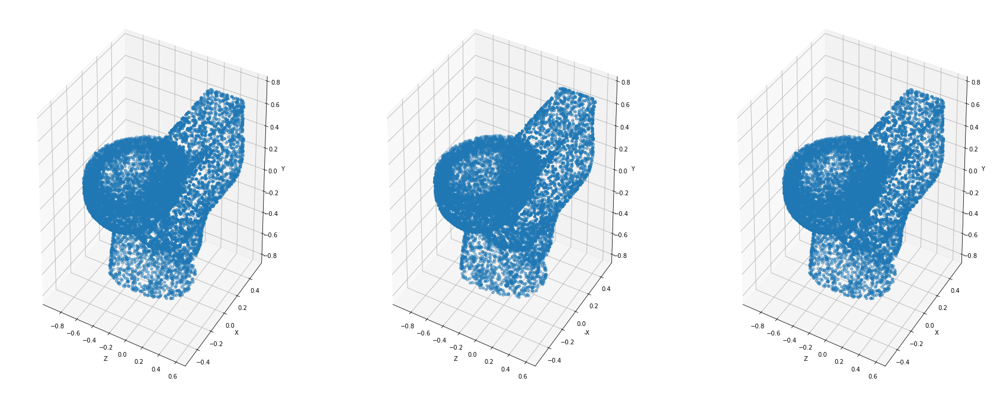

In [ ]:
fig = plt.figure(figsize=(30,12))


ax = fig.add_subplot(1, 3, 1, projection='3d')
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax2 = fig.add_subplot(1, 3, 2, projection='3d', sharex=ax)
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]

ax2.scatter3D(Z,-X,Y)
ax2.set_xlabel('Z')
ax2.set_ylabel('-X')
ax2.set_zlabel('Y')


ax3 = fig.add_subplot(1, 3, 3, projection='3d', sharex=ax)
X = ptts[:,0]
Y = ptts[:,1]
Z = ptts[:,2]
ax3.scatter3D(Z,X,Y)
ax3.set_xlabel('Z')
ax3.set_ylabel('X')
ax3.set_zlabel('Y')

plt.show()

##1.1 Primer segmento, todo diferente menos la cabina, con divisiones irregulares

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if (ptts[i][0]>0 and ptts[i][0]<0.2):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0]< 0):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

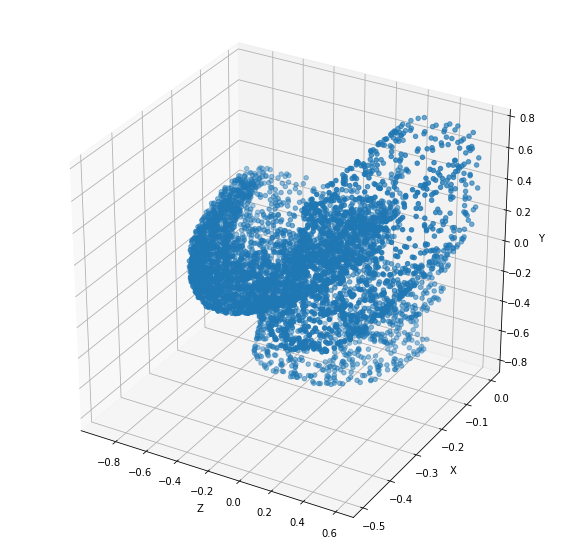

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

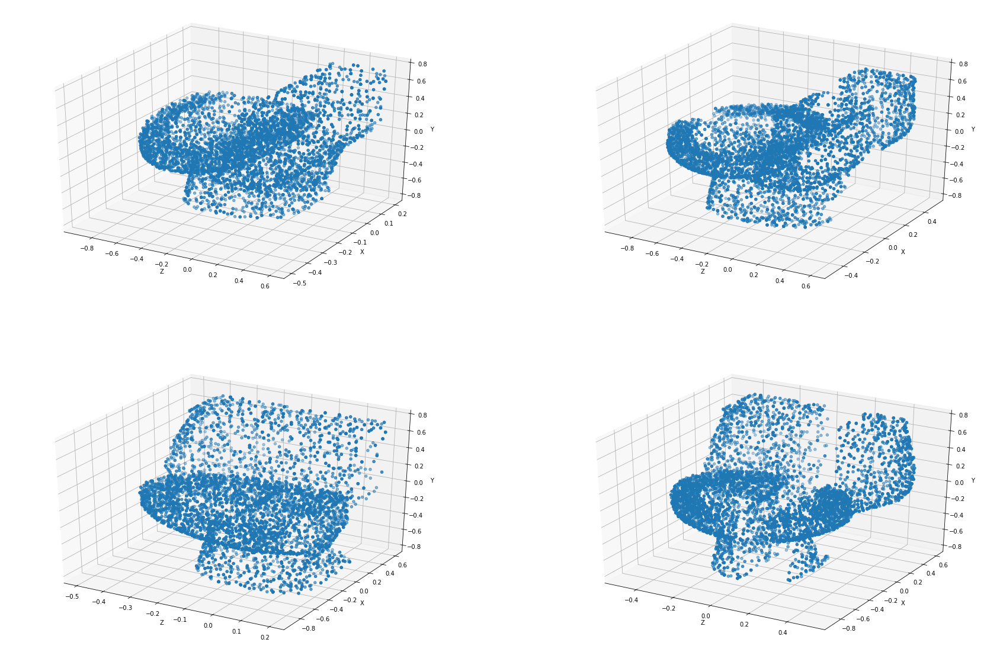

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

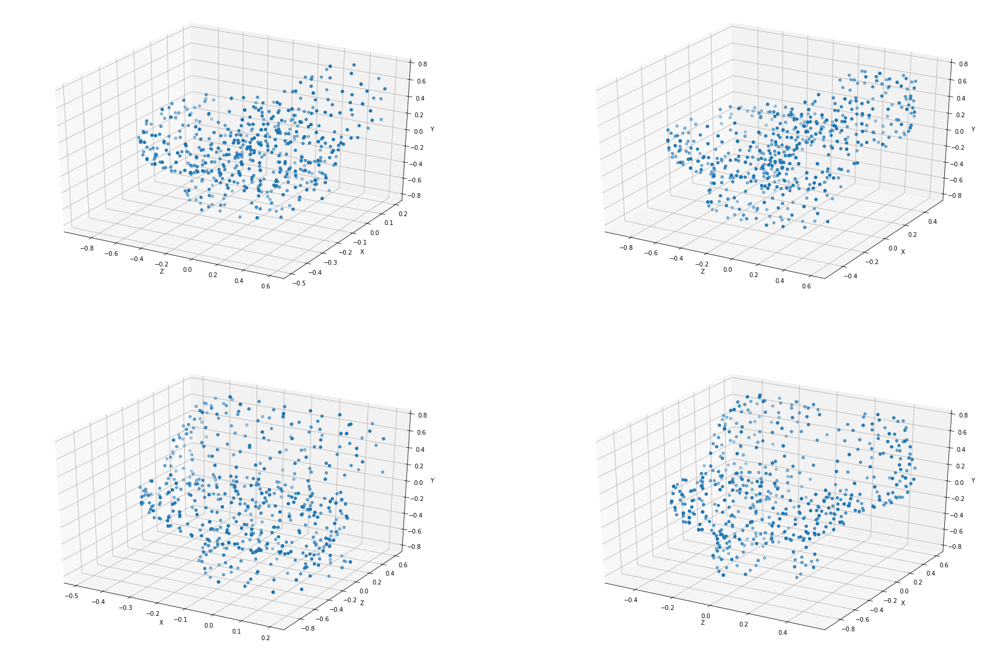

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.1.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.327570
1,1,1,0.015821
2,2,2,0.015821
3,3,3,0.327570
4,4,4,0.015821
...,...,...,...
1019,1019,1019,0.321371
1020,1020,1020,0.288518
1021,1021,1021,0.135267
1022,1022,1022,0.068966


In [ ]:
similaresB=[]
diferentesB=[]
simB = []
difB = []
rango = 0.00001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similaresB.append(m['m_punto_pcB'][i])
    simB.append(pcB[i])
  else:
    diferentesB.append(m['m_punto_pcB'][i])
    difB.append(pcB[i])

In [ ]:
len(similaresB)

549

In [ ]:
len(diferentesB)

475

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similaresB)):
    if(similaresB[j]==i):
      dst = distance.euclidean(pcA[similaresB[j]], pcB[similaresB[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
difB = np.array(difB)
simB = np.array(simB)

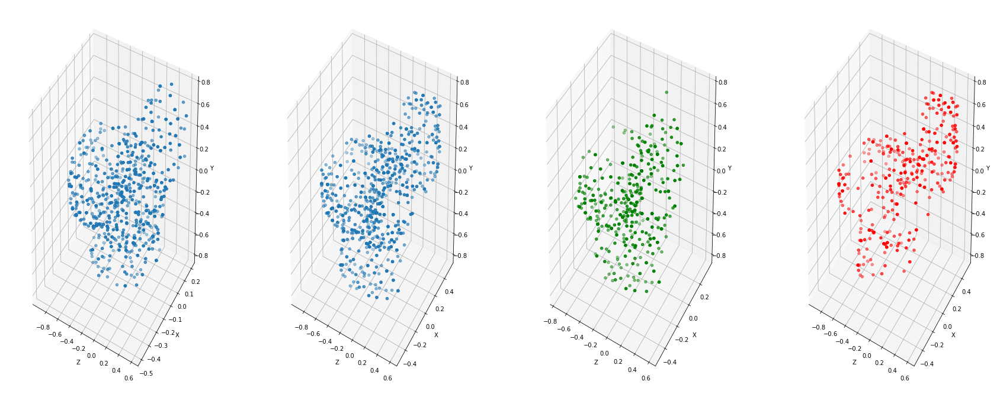

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = simB[:,0]
Y = simB [:,1]
Z = simB[:,2]
ax.scatter3D(Z,X,Y, c='green')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = difB[:,0]
Y = difB [:,1]
Z = difB[:,2]
ax.scatter3D(Z,X,Y, c='red')
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.08195857900663271, 0.010980367528814674, 'Y')

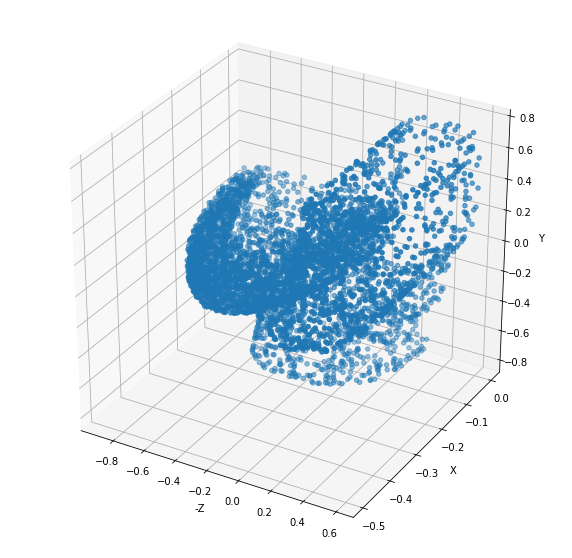

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax1 = fig.add_subplot(1, 1, 1, projection='3d', sharex=ax, sharey=ax)
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax1.scatter3D(Z,X,Y)
ax1.set_xlabel('-Z')
ax1.set_ylabel('X')
ax1.set_zlabel('Y')

####1.1.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.026796
1,1,1,0.026796
2,2,2,0.022547
3,3,3,0.030230
4,4,4,0.026796
...,...,...,...
1019,1019,1019,0.000000
1020,1020,1020,0.000000
1021,1021,1021,0.017374
1022,1022,1022,0.000000


In [ ]:
similaresA=[]
diferentesA=[]
simA = []
difA = []
rango = 0.0000001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similaresA.append(m['n_punto_pcA'][i])
    simA.append(pcA[i])
  else:
    diferentesA.append(m['n_punto_pcA'][i])
    difA.append(pcA[i])

In [ ]:
len(similaresA)

612

In [ ]:
len(diferentesA)

412

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similaresA)):
    if(similaresA[j]==i):
      dst = distance.euclidean(pcA[similaresA[j]], pcB[similaresA[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
difA = np.array(difA)
simA = np.array(simA)

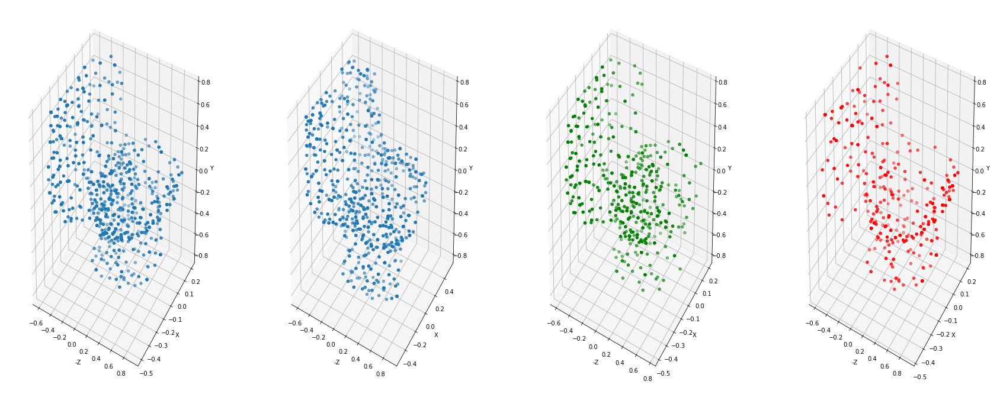

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = simA[:,0]
Y = simA [:,1]
Z = simA[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = difA[:,0]
Y = difA [:,1]
Z = difA[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

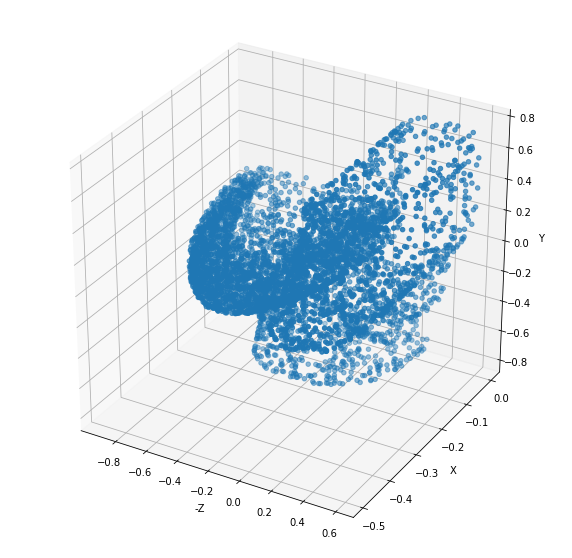

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####Coincidentes

In [ ]:
coincidentesIndices = p_coincidentes_PcAyPcB(similaresA, similaresB)

print(len(coincidentesIndices))

coincidentesNube = []
coincidentesA = []
coincidentesB = []
for x in coincidentesIndices:
  coincidentesNube.append(ptts[x])
  coincidentesA.append(nubeA[x])
  coincidentesB.append(nubeB[x])

coincidentesNube = np.array(coincidentesNube)
coincidentesA = np.array(coincidentesA)
coincidentesB = np.array(coincidentesB)

294


Text(0.5, 0, 'Y')

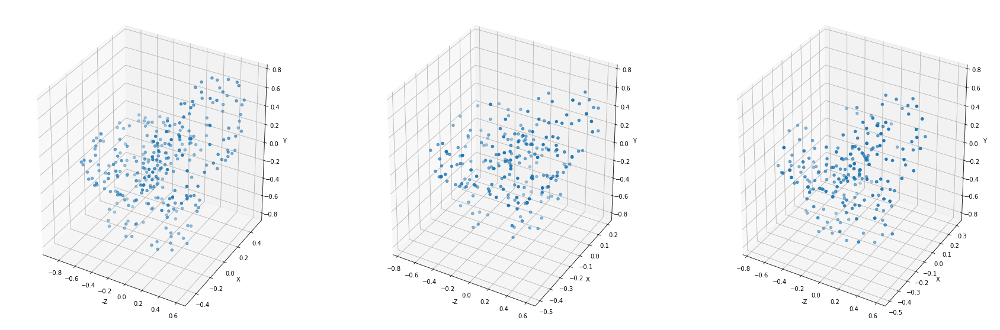

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(30,10))

ax = fig.add_subplot(1, 3, 1, projection='3d')
X = coincidentesNube[:,0]
Y = coincidentesNube[:,1]
Z = coincidentesNube[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(1, 3, 2, projection='3d')
X = coincidentesA[:,0]
Y = coincidentesA[:,1]
Z = coincidentesA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(1, 3, 3, projection='3d')
X = coincidentesB[:,0]
Y = coincidentesB[:,1]
Z = coincidentesB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

##1.2 Segundo Segmento, Modelo dividido en dos con areas en común en la mitad

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0.1 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0.1) and (ptts[i][0] < 0.2):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

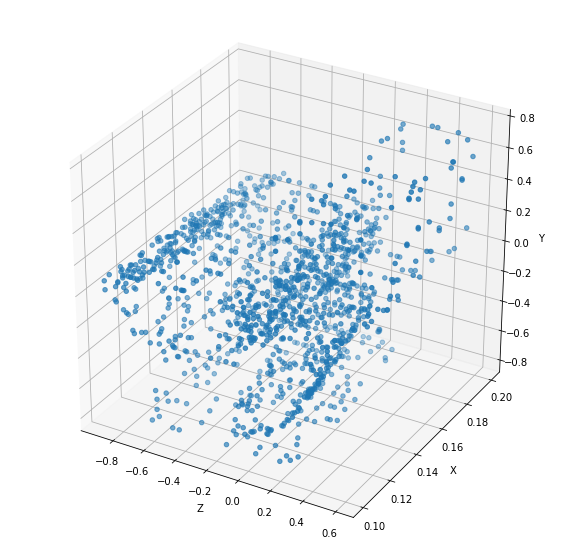

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

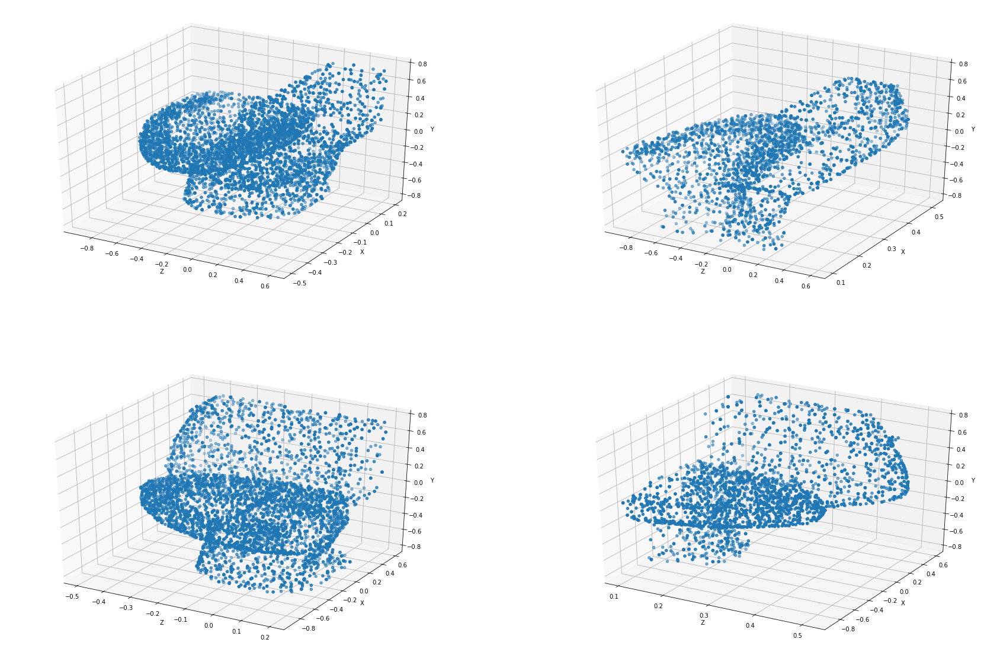

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

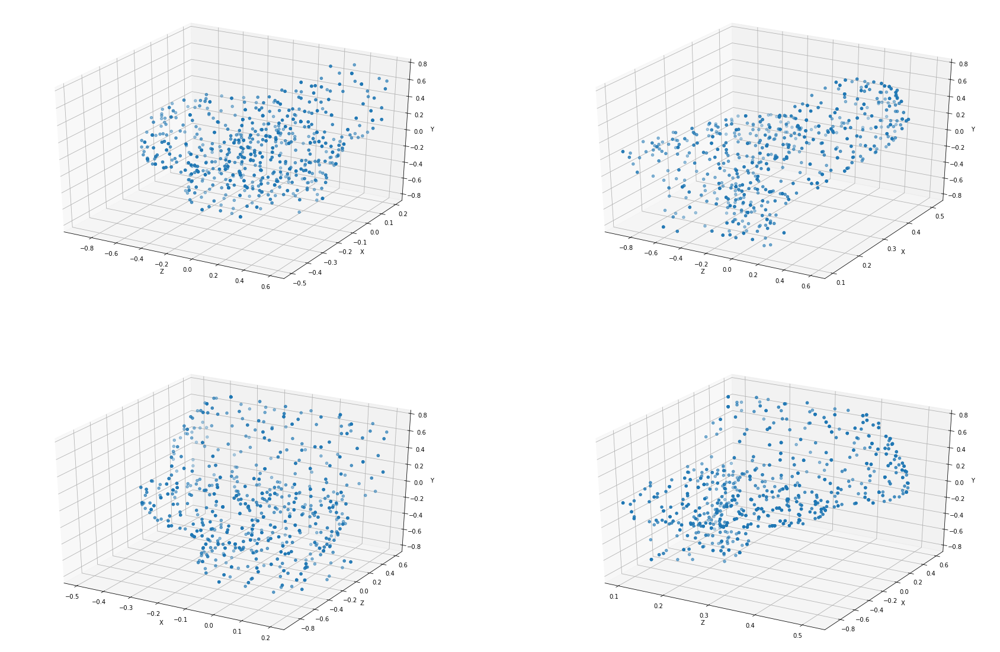

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.2.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.337600
1,1,1,0.379648
2,2,2,0.379648
3,3,3,0.000000
4,4,4,0.000000
...,...,...,...
1019,1019,1019,0.090729
1020,1020,1020,0.154310
1021,1021,1021,0.076532
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.000001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

291

In [ ]:
len(diferentes)

733

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

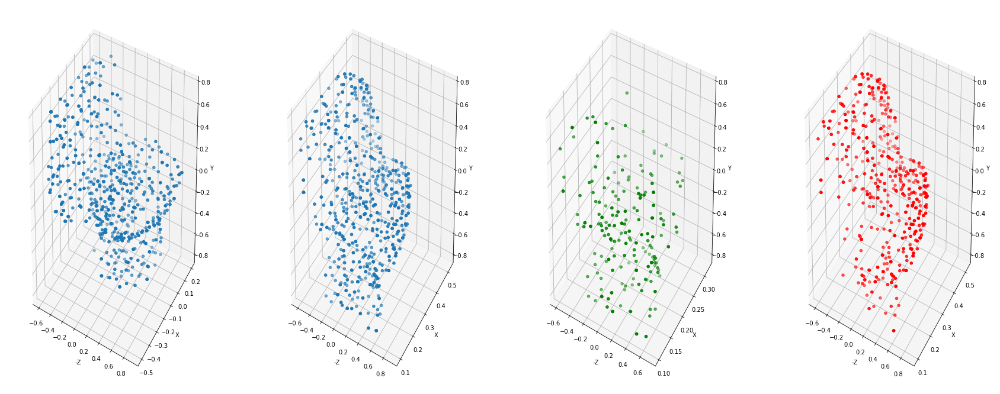

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif[:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

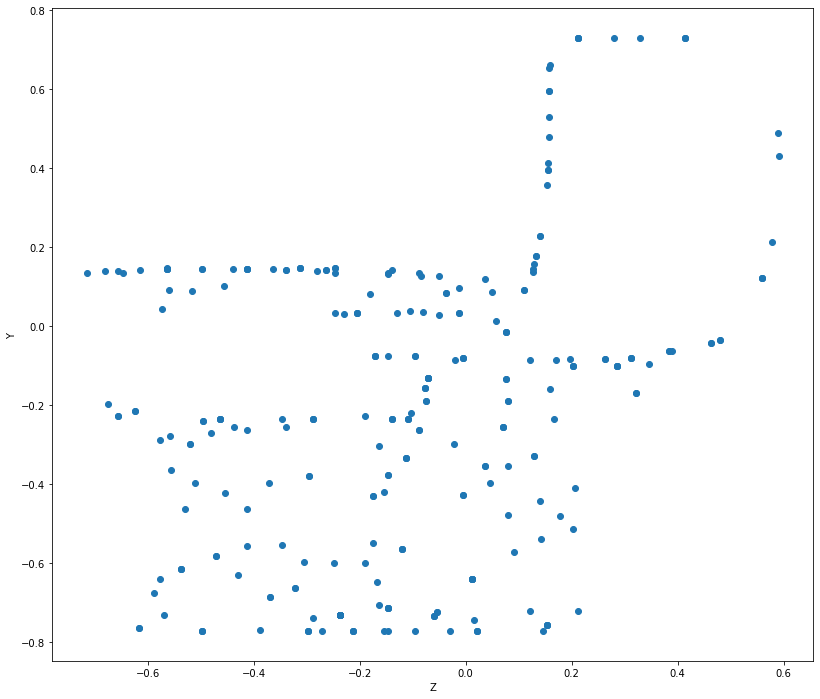

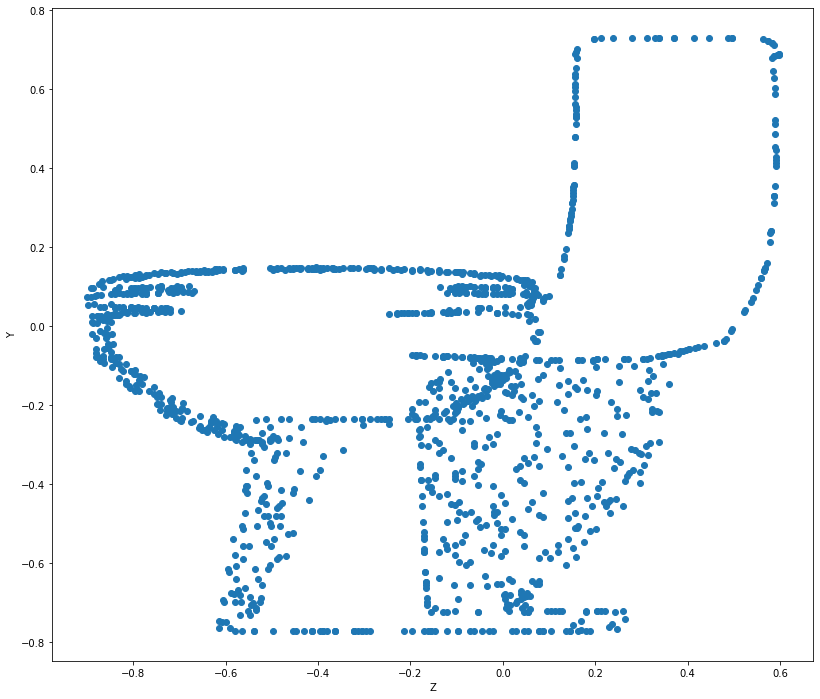

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1)
Y = sim [:,1]
Z = sim[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 2)
Y = inteseccion[:,1]
Z = inteseccion[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

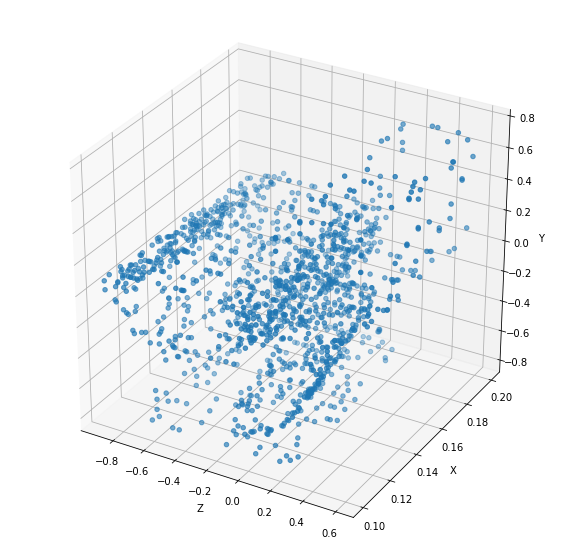

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.2.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.188763
1,1,1,0.641465
2,2,2,0.641465
3,3,3,0.476578
4,4,4,0.476578
...,...,...,...
1019,1019,1019,0.323138
1020,1020,1020,0.150084
1021,1021,1021,0.567280
1022,1022,1022,0.229421


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00001
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

132

In [ ]:
len(diferentes)

892

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

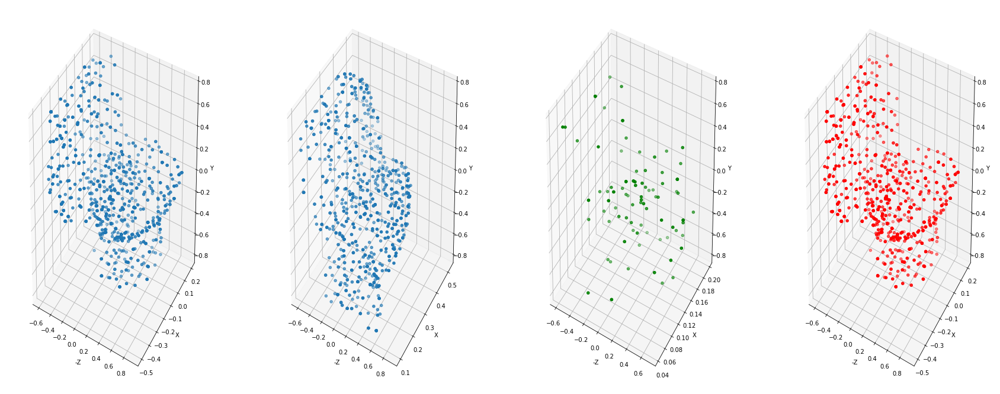

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0, 0.5, 'Y')

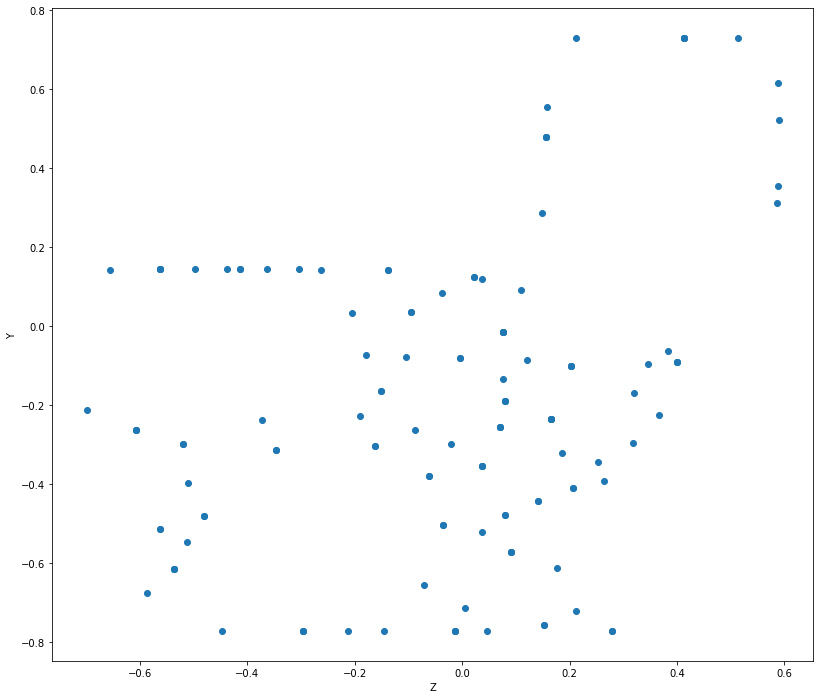

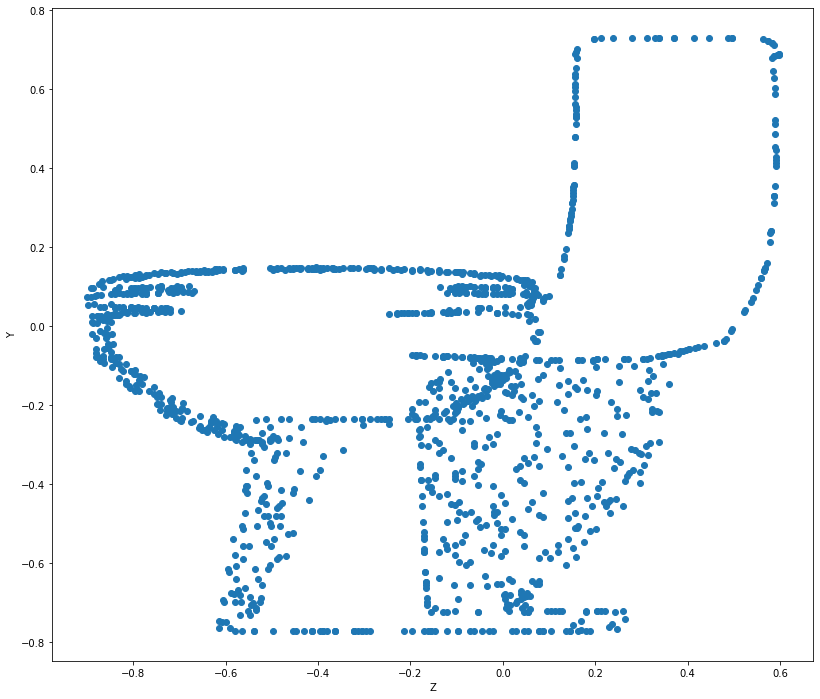

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 1)
Y = sim [:,1]
Z = sim[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 2, 2)
Y = inteseccion[:,1]
Z = inteseccion[:,2]
ax.scatter(Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('Y')

Text(0.5, 0, 'Y')

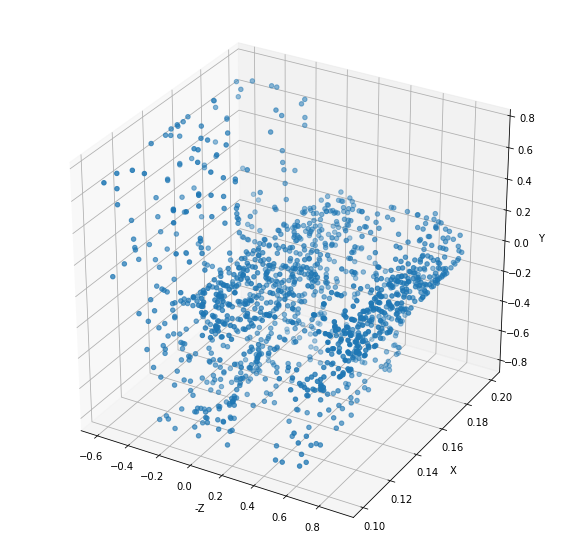

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

##1.3 Tercer Segmento, Modelo dividido en dos con areas en común en la cola

In [ ]:
#Segmento el avión en 2 nubes

nubeA = []
nubeB = []
inteseccion = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0]<0 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    coordenadas = []
  elif(ptts[i][0] > 0.4):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeA.append(coordenadas)
    nubeB.append(coordenadas)
    inteseccion.append(coordenadas)
    coordenadas = []
  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])

    nubeB.append(coordenadas)
    coordenadas = []


# coordenadas = []
# for i in range(len(ptts)):
#   if (ptts[i][0]<-0.32):
#     coordenadas.append(ptts[i][0])
#     coordenadas.append(ptts[i][1])
#     coordenadas.append(ptts[i][2])
#     nubeB.append(coordenadas)
#     coordenadas = []


In [ ]:
nubeA = np.array(nubeA)
nubeB = np.array(nubeB)
inteseccion = np.array(inteseccion)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA)
random.shuffle(nubeB)

Text(0.5, 0, 'Y')

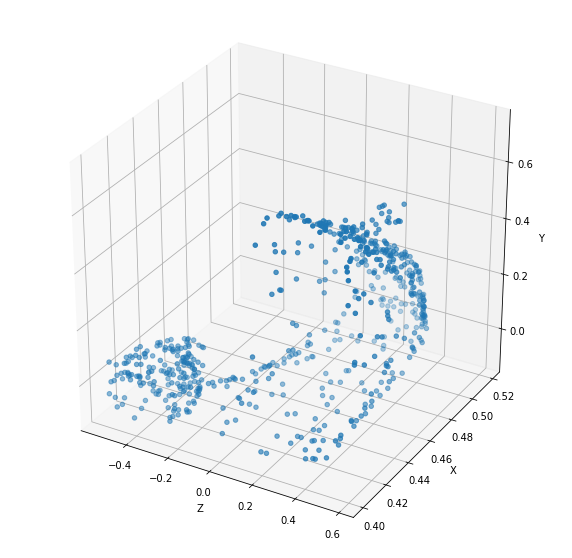

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

Text(0.5, 0, 'Y')

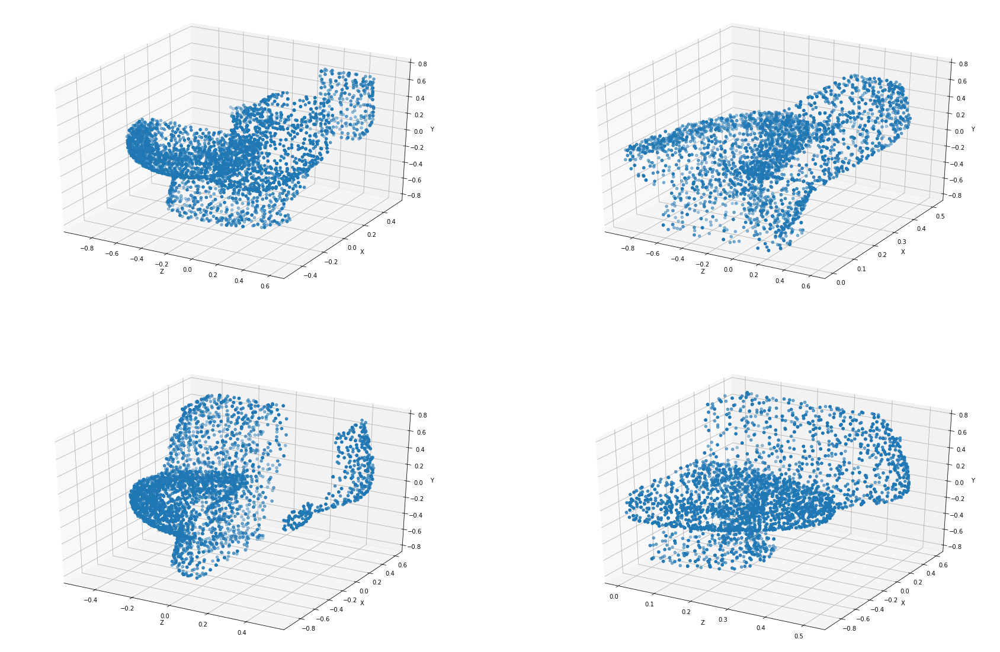

In [ ]:
#Nubes A y B
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

In [ ]:
nubeA = nubeA[:1024]
nubeB = nubeB[:1024]

Text(0.5, 0, 'Y')

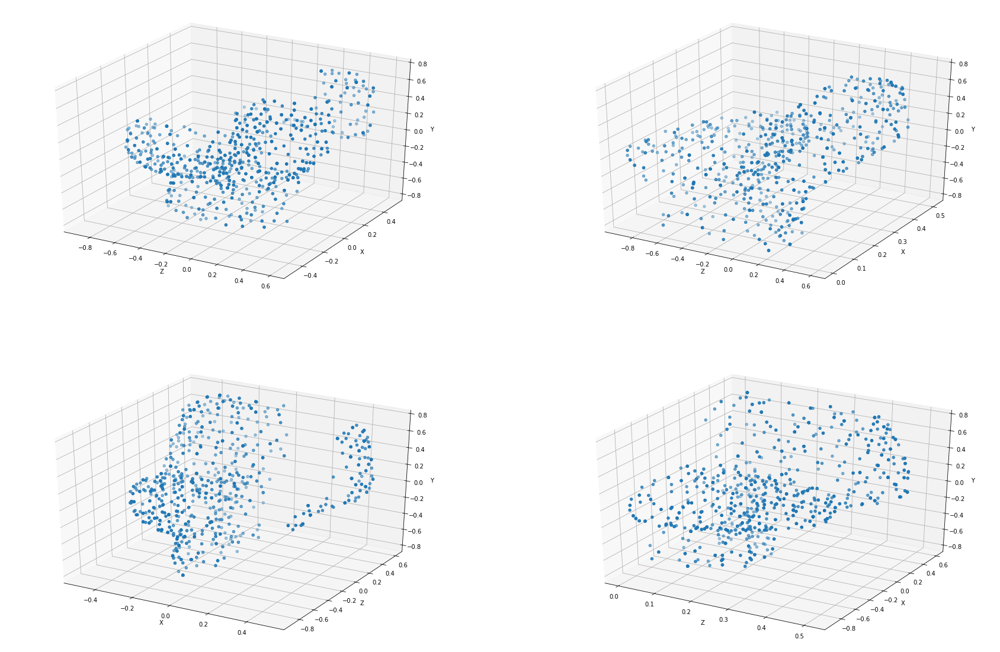

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA[:,0]
Y = nubeA[:,1]
Z = nubeA[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB[:,0]
Y = nubeB[:,1]
Z = nubeB[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

###Evaluamos DPDist

In [ ]:
pcA, pcB = nubeA, nubeB

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


####1.3.1 Prueba DistAB sobre nubeB

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.016043
1,1,1,0.393159
2,2,2,0.016043
3,3,3,0.000000
4,4,4,0.393159
...,...,...,...
1019,1019,1019,0.089455
1020,1020,1020,0.215843
1021,1021,1021,0.000000
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.0000001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

506

In [ ]:
len(diferentes)

518

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

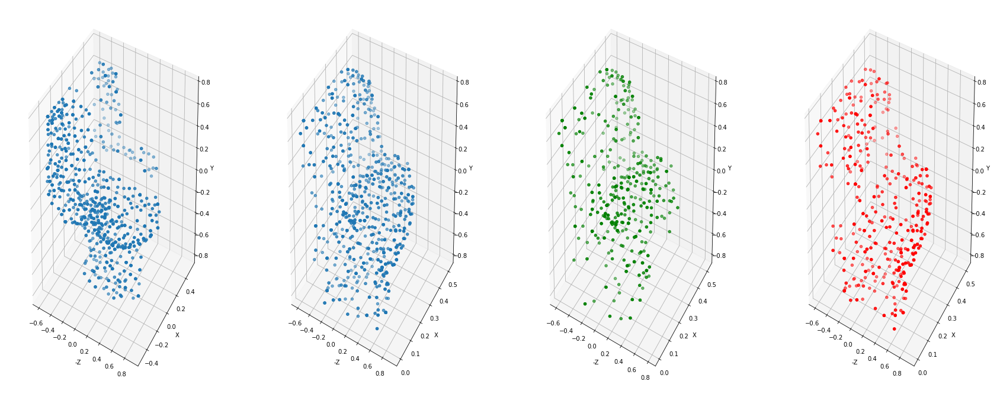

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

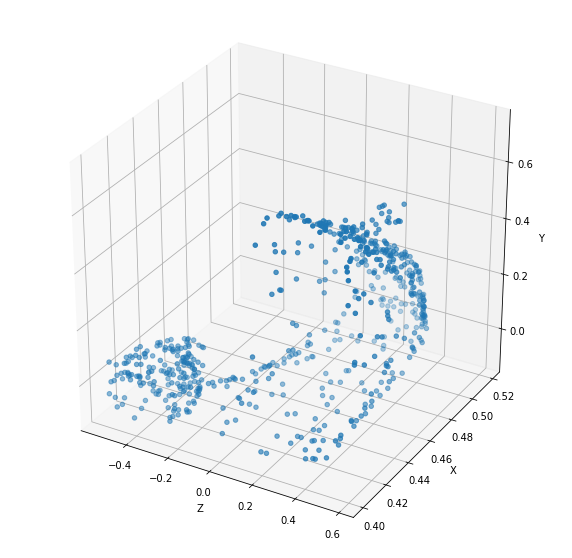

In [ ]:
2#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

####1.3.2 Prueba DistBA sobre nubeA 

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.003046
1,1,1,0.003046
2,2,2,0.003046
3,3,3,0.225782
4,4,4,0.594876
...,...,...,...
1019,1019,1019,0.233644
1020,1020,1020,0.000000
1021,1021,1021,0.310642
1022,1022,1022,0.076974


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.125
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

260

In [ ]:
len(diferentes)

764

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
import random
random.shuffle(edist)

In [ ]:
dif = np.array(dif)
sim = np.array(sim)

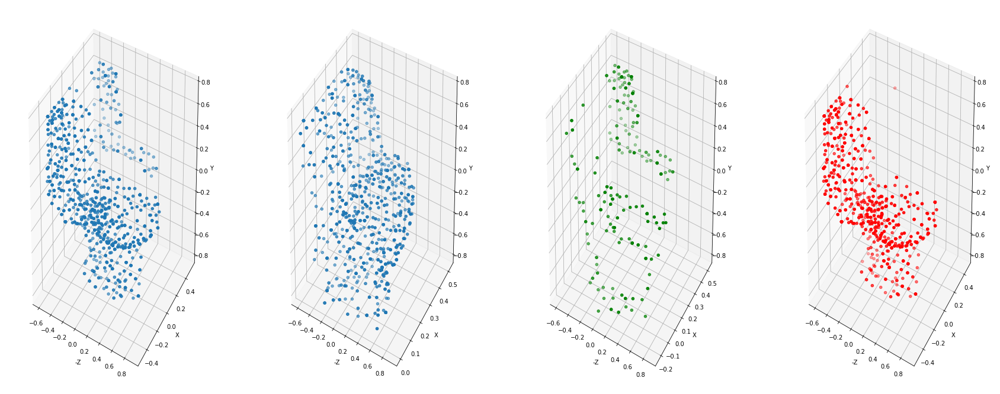

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()

Text(0.5, 0, 'Y')

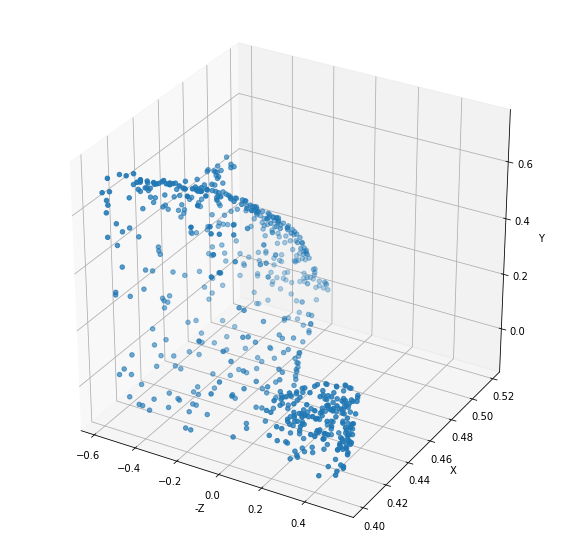

In [ ]:
#Área de intersección
fig = plt.figure(figsize=(10,10))


ax = fig.add_subplot(1, 1, 1, projection='3d')
X = inteseccion[:,0]
Y = inteseccion[:,1]
Z = inteseccion[:,2]

ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

#Segundo modelo

In [ ]:
#Segmento el avión en 2 nubes

nubeA2 = []
nubeB2 = []
coordenadas = []
for i in range(len(ptts)):
  if ptts[i][0] < 0.2 :
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])
    nubeA2.append(coordenadas)
    coordenadas = []

  elif (ptts[i][0] > 0.6):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])
    nubeA2.append(coordenadas)
    nubeB2.append(coordenadas)
    coordenadas = []

  else:
    coordenadas = []
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])
    nubeB2.append(coordenadas)
    coordenadas = []


'''
  elif (ptts[i][0] > 0.2) and (ptts[i][0] < 0.5):
    coordenadas.append(ptts[i][0])
    coordenadas.append(ptts[i][1])
    coordenadas.append(ptts[i][2])
    nubeA2.append(coordenadas)
    nubeB2.append(coordenadas)
    coordenadas = []
'''

'\n  elif (ptts[i][0] > 0.2) and (ptts[i][0] < 0.5):\n    coordenadas.append(ptts[i][0])\n    coordenadas.append(ptts[i][1])\n    coordenadas.append(ptts[i][2])\n    nubeA2.append(coordenadas)\n    nubeB2.append(coordenadas)\n    coordenadas = []\n'

In [ ]:
nubeA2 = np.array(nubeA2)
nubeB2 = np.array(nubeB2)

In [ ]:
#Mezclo los puntos
import random

random.shuffle(nubeA2)
random.shuffle(nubeB2)

In [ ]:
nubeA2 = nubeA2[:1024]
nubeB2 = nubeB2[:1024]

Text(0.5, 0, 'Y')

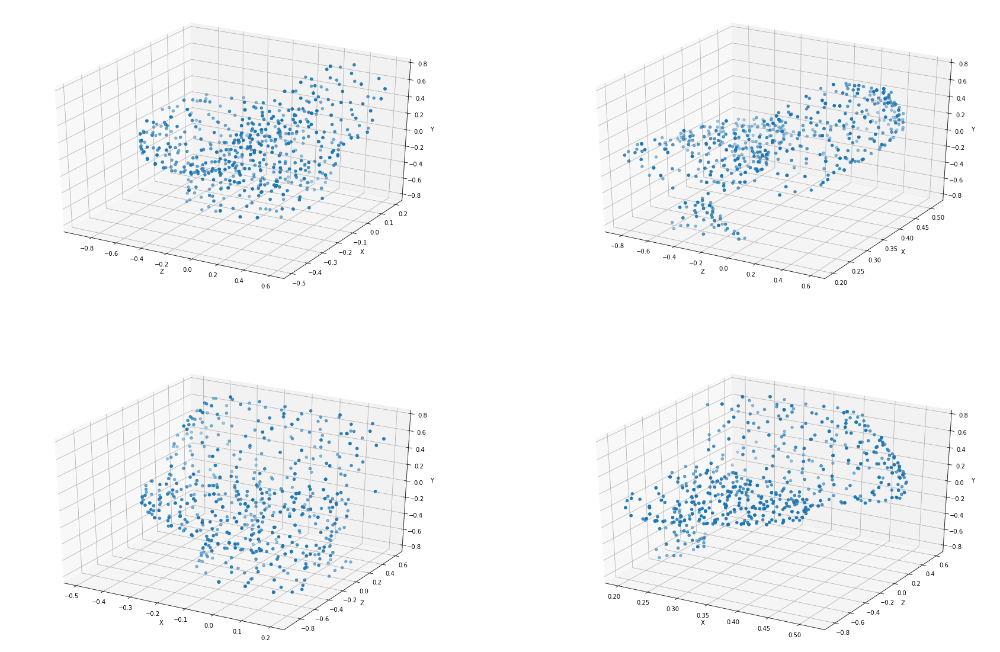

In [ ]:
fig = plt.figure(figsize=(30,20))


ax = fig.add_subplot(2, 2, 1, projection='3d')
X = nubeA2[:,0]
Y = nubeA2[:,1]
Z = nubeA2[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 2, projection='3d')
X = nubeB2[:,0]
Y = nubeB2[:,1]
Z = nubeB2[:,2]

ax.scatter3D(Z,X,Y)
ax.set_xlabel('Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')

ax = fig.add_subplot(2, 2, 3, projection='3d')
X = nubeA2[:,0]
Y = nubeA2[:,1]
Z = nubeA2[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(2, 2, 4, projection='3d')
X = nubeB2[:,0]
Y = nubeB2[:,1]
Z = nubeB2[:,2]

ax.scatter3D(X,Z,Y)
ax.set_xlabel('X')
ax.set_ylabel('Z')
ax.set_zlabel('Y')

#DPDist


In [ ]:
pcA, pcB = nubeA, nubeB

/usr/local/lib/python3.7/dist-packages/numpy/core/fromnumeric.py:3373: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.7/dist-packages/numpy/core/_methods.py:163: RuntimeWarning: invalid value encountered in true_divide
  ret, rcount, out=ret, casting='unsafe', subok=False)
ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-37-3a309adc5507>", line 1, in <module>
    pcA, pcB = muestro_resimple2(nubeA, nubeB)
  File "<ipython-input-36-341d193049a5>", line 73, in muestro_resimple2
    pcB = pc_normalize(pcB)
  File "<ipython-input-36-341d193049a5>", line 44, in pc_normalize
    m = np.max(np.sqrt(np.sum(pc**2, axis=1)))
  File "<__array_function__ internals>", line 6, in amax
  File "/usr/local/lib/python3.7/dist-packages/numpy/core/fromnumeric.py", line 2706, in amax
    keepdims=keepdims, initial=initial, where=where)
  File "/usr/local/lib/python3.7/dist-packages/numpy/core/fromnumeric.py", line 87, in _wrapreduction
    return ufunc.reduce(obj, axis, dtype, out, **passkwargs)
ValueError: zero-size array to reduction operation maximum which has no identity

During handling of the above excep

ValueError: ignored

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

ERROR:root:Internal Python error in the inspect module.
Below is the traceback from this internal error.



Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 2882, in run_code
    exec(code_obj, self.user_global_ns, self.user_ns)
  File "<ipython-input-23-73c8a4a49f79>", line 1, in <module>
    DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)
NameError: name 'pcA' is not defined

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py", line 1823, in showtraceback
    stb = value._render_traceback_()
AttributeError: 'NameError' object has no attribute '_render_traceback_'

During handling of the above exception, another exception occurred:

Traceback (most recent call last):
  File "/usr/local/lib/python3.7/dist-packages/IPython/core/ultratb.py", line 1132, in get_records
    return _fixed_getinnerframes(etb, number_of_lines_of_context, tb_offset)
  File "/usr/local/lib/python3.7/dist-packages/IPython/

NameError: ignored

In [ ]:
DistAB.shape

(1024,)

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.000000
1,1,1,0.247820
2,2,2,0.059387
3,3,3,0.067791
4,4,4,0.000000
...,...,...,...
1019,1019,1019,0.270941
1020,1020,1020,0.065775
1021,1021,1021,0.041459
1022,1022,1022,0.000000


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.15
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

866

In [ ]:
similares[0:10]

[0, 2, 3, 4, 5, 6, 7, 8, 9, 11]

In [ ]:
len(diferentes)

158

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
len(edist)

866

In [ ]:
import random
random.shuffle(edist)

In [ ]:
edist[0:10]

[0.6069518242233195,
 0.6472018467407129,
 0.28904369309927963,
 0.5289431172065322,
 0.24436931556713012,
 1.0643863723008635,
 0.5716922989995973,
 0.4724953707057556,
 0.6308932370518172,
 0.7653044846938731]

In [ ]:
dif = np.array(dif)

In [ ]:
sim = np.array(sim)

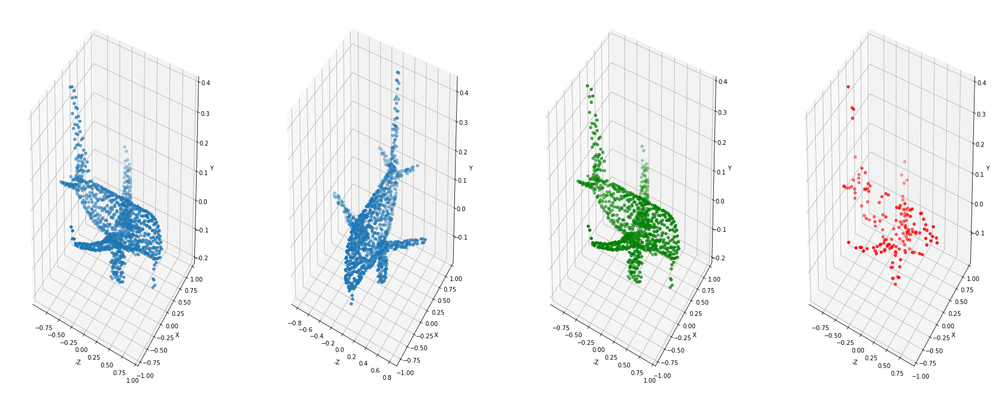

In [ ]:
fig = plt.figure(figsize=(30,12))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()


#Segundo DPDist (Cola de avión en común)

In [ ]:
pcA, pcB = nubeA2, nubeB2

In [ ]:
DistAB, DistBA, DPDistAB=DPDist(pcA, pcB)

/usr/local/lib/python3.7/dist-packages/tensorflow/python/client/session.py:1771: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


##Caso DistAB

In [ ]:
DistAB.shape

(1024,)

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistAB': DistAB}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistAB
0,0,0,0.119604
1,1,1,0.119604
2,2,2,0.110110
3,3,3,0.110110
4,4,4,0.000000
...,...,...,...
1019,1019,1019,0.000000
1020,1020,1020,0.052951
1021,1021,1021,0.009469
1022,1022,1022,0.069315


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.00000001
for i in range(len(m['DPDistAB'])):
  if(m['DPDistAB'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcB[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcB[i])

In [ ]:
len(similares)

465

In [ ]:
similares[0:10]

[4, 6, 9, 10, 16, 20, 21, 22, 27, 33]

In [ ]:
len(diferentes)

559

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
len(edist)

465

In [ ]:
import random
random.shuffle(edist)

In [ ]:
edist[0:10]

[0.723246078592895,
 0.5690982721367198,
 0.3803907145830456,
 0.6272553328589562,
 0.9687407032328103,
 0.8652183553878177,
 0.9053979868853255,
 0.9881025068281124,
 1.229559863569074,
 0.6032127516888217]

In [ ]:
dif = np.array(dif)

In [ ]:
sim = np.array(sim)

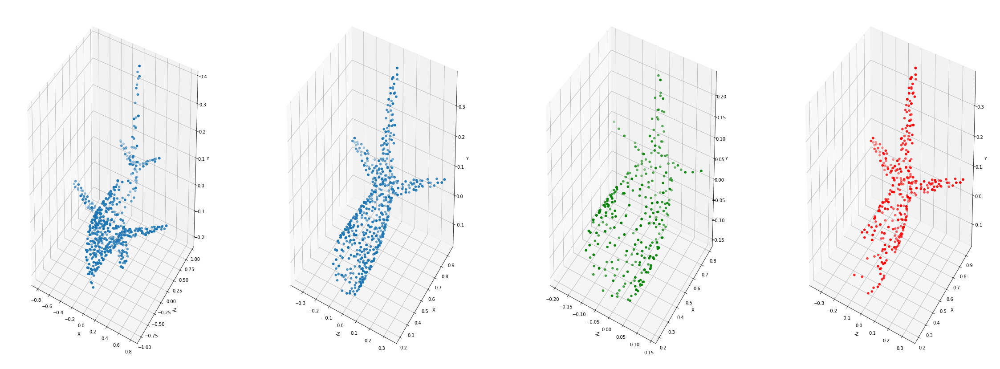

In [ ]:
fig = plt.figure(figsize=(40,15))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('X')
ax.set_ylabel('-Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()


##Caso DistBA

In [ ]:
datos = {'n_punto_pcA':range(pcA.shape[0]), 'm_punto_pcB': range(pcB.shape[0]), 'DPDistBA': DistBA}

In [ ]:
import pandas as pd
m = pd.DataFrame(datos)
m

,n_punto_pcA,m_punto_pcB,DPDistBA
0,0,0,0.404248
1,1,1,0.747816
2,2,2,0.747816
3,3,3,0.404248
4,4,4,0.404248
...,...,...,...
1019,1019,1019,0.521895
1020,1020,1020,1.342795
1021,1021,1021,0.889351
1022,1022,1022,0.809527


In [ ]:
similares=[]
diferentes=[]
sim = []
dif = []
rango = 0.1
for i in range(len(m['DPDistBA'])):
  if(m['DPDistBA'][i]<=rango):
    similares.append(m['n_punto_pcA'][i])
    sim.append(pcA[i])
  else:
    diferentes.append(m['n_punto_pcA'][i])
    dif.append(pcA[i])

In [ ]:
len(similares)

149

In [ ]:
similares[0:10]

[16, 20, 25, 30, 41, 46, 50, 56, 58, 67]

In [ ]:
len(diferentes)

875

In [ ]:
from scipy.spatial import distance

edist = []
for i in range(len(pcA)):
  for j in range(len(similares)):
    if(similares[j]==i):
      dst = distance.euclidean(pcA[similares[j]], pcB[similares[j]])
      edist.append(dst)

In [ ]:
len(edist)

149

In [ ]:
import random
random.shuffle(edist)

In [ ]:
edist[0:10]

[0.2101055691789249,
 0.22952873946632482,
 0.3408016150255159,
 0.3552546165780256,
 0.7772062150581402,
 0.6467167653811057,
 0.31611561255338216,
 0.16367038828083713,
 0.5276074113400985,
 0.3633950442713825]

In [ ]:
dif = np.array(dif)

In [ ]:
sim = np.array(sim)

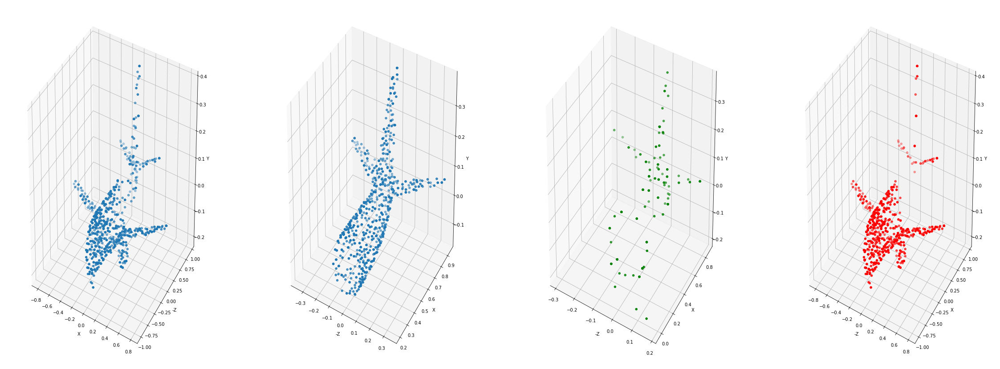

In [ ]:
fig = plt.figure(figsize=(40,15))
ax = fig.add_subplot(1, 4, 1, projection='3d')
X = pcA[:,0]
Y = pcA [:,1]
Z = pcA[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('X')
ax.set_ylabel('-Z')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 2, projection='3d')
X = pcB[:,0]
Y = pcB [:,1]
Z = pcB[:,2]
ax.scatter3D(-Z,X,Y)
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 3, projection='3d')
X = sim[:,0]
Y = sim [:,1]
Z = sim[:,2]
ax.scatter3D(-Z,X,Y, c='green')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')


ax = fig.add_subplot(1, 4, 4, projection='3d')
X = dif[:,0]
Y = dif [:,1]
Z = dif[:,2]
ax.scatter3D(-Z,X,Y, c='red')
ax.set_xlabel('-Z')
ax.set_ylabel('X')
ax.set_zlabel('Y')
plt.show()
